In [1]:
import json
import os
import matplotlib.pyplot as plt
import pandas as pd
import scipy.stats
from scipy.stats import kstest
import numpy as np
import networkx as nx
import pydot
from networkx.drawing.nx_pydot import graphviz_layout
import powerlaw
from statsmodels.api import qqplot
from datetime import datetime, timedelta
from collections import defaultdict

import utils.processing_utils as pu
import utils.simulation_utils as su

np.set_printoptions(legacy="1.25")

In [2]:
experimental_condition = True
save_figs = False
# start_str="reddit-sim_qwen_subreddit-3-24h"
if experimental_condition:
    simulated_conditions = [1, 6]

***
# Load Data

In [30]:
# Load User data and discussions data
user_data = pd.read_csv(
    "/../abyss/home/oasis/data/seed_user_data.csv"
)

discussions_data = pd.read_csv(
    "/../abyss/home/oasis/data/seed_discussions_data.csv"
)

# change post_id in two cases to fit actual post_id
discussions_data.at[679, "post_id"] = "t3_1dfbrcy"
discussions_data.at[680, "post_id"] = "t3_1dfbrcy"

if experimental_condition:
    user_data = user_data[user_data["subreddit"].isin(simulated_conditions)]
    discussions_data = discussions_data[discussions_data["subreddit"].isin(simulated_conditions)]

In [4]:
sim_discussions_data = pd.read_csv(
    "/../abyss/home/oasis/data/sim_discussions_data.csv"
)
sim_user_data = pd.read_csv(
    "/../abyss/home/oasis/data/sim_user_data.csv"
)
sim_trace_data = pd.read_csv(
    "/../abyss/home/oasis/data/sim_trace_data.csv"
)

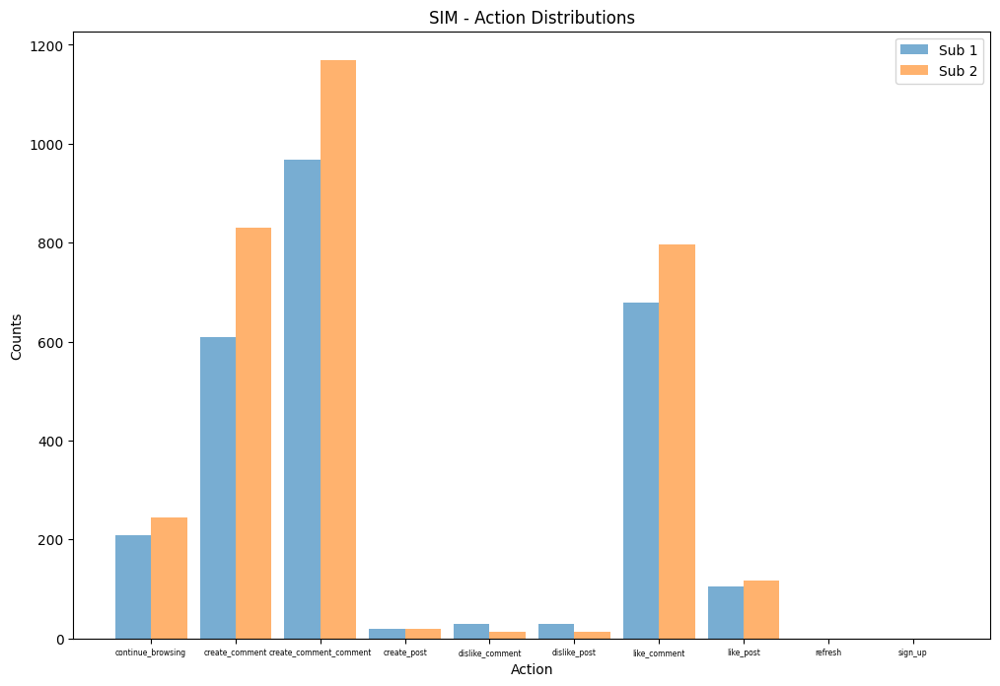

In [5]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
l = 1
bar_width = 0.85 / len(sim_trace_data["subreddit"].unique())

all_actions = sorted(sim_trace_data["action"].unique())
x = np.arange(len(all_actions))

for i, data in sim_trace_data.groupby("subreddit"):
    try:
        temp = data[~data["action"].isin(["refresh", "sign_up"])].sort_values("action")
        cats = temp["action"].unique()
        counts = temp.groupby("action").size()

        # Create a dictionary to map actions to their counts
        counts_dict = dict(zip(cats, counts))

        # Ensure all actions are represented in the counts
        counts = [counts_dict.get(action, 0) for action in all_actions]

        # Calculate the position for this set of bars
        bar_positions = x + (l - 1) * bar_width

        ax.bar(bar_positions, counts, width=bar_width, alpha=0.6, label=f"Sub {l}")
        ax.tick_params(axis="x", labelsize=5.5)

        ax.set_xlabel("Action")
        ax.set_ylabel("Counts")
        ax.set_title("SIM - Action Distributions")
        ax.set_xticks(x + bar_width * (len(sim_trace_data["subreddit"].unique()) - 1) / 2)
        ax.set_xticklabels(all_actions)

        l += 1
    except Exception as e:
        print(f"Error processing subset {l}: {e}")
        l += 1

ax.legend()
plt.show()

***
# Structural Analysis

In [6]:
# Comparison of 

def round_mean(data, mode="mean", digits=3):
    if mode == "mean":
        return round(np.mean(data), digits)
    elif mode == "median":
        return round(np.median(data), digits)

seed_avg_comment_count = round_mean(user_data["comment_count"])
seed_median_comment_count = round_mean(
    user_data["comment_count"], mode="median"
)
seed_avg_score_comment = round_mean(discussions_data["score_comment"])
seed_median_score_comment = round_mean(
    discussions_data["score_comment"], mode="median"
)
seed_min_score_comment = min(discussions_data["score_comment"])
seed_max_score_comment = max(discussions_data["score_comment"])


sim_avg_comment_count = round_mean(sim_user_data["sim_comment_count"])
sim_median_comment_count = round_mean(
    sim_user_data["sim_comment_count"], mode="median"
)
sim_avg_score_comment = round_mean(sim_discussions_data["sim_score_comment"])
sim_median_score_comment = round_mean(
    sim_discussions_data["sim_score_comment"], mode="median"
)
sim_min_score_comment = min(sim_discussions_data["sim_score_comment"])
sim_max_score_comment = max(sim_discussions_data["sim_score_comment"])


print("{:<30}{:^10}|{:^10}".format("All Users/Agents", "Seed", "Sim"))
print("-"*50)
print("{:<30}{:^10}|{:^10}".format("N Agents", len(user_data), len(sim_user_data)))
print("{:<30}{:^10}|{:^10}".format("N Active Agents", len(user_data[user_data["comment_count"] != 0]), len(sim_user_data[sim_user_data["sim_comment_count"] != 0])))
print("{:<30}{:^10}|{:^10}".format("N Silent Agents", len(user_data[user_data["comment_count"] == 0]), len(sim_user_data[sim_user_data["sim_comment_count"] == 0])))
print("{:<30}{:^10}|{:^10}".format("N Comments", len(discussions_data), len(sim_discussions_data)))
print("-"*50)
print("{:<30}{:^10}|{:^10}".format("Average Comment Count:", seed_avg_comment_count, sim_avg_comment_count))
print("{:<30}{:^10}|{:^10}".format("Median Comment Count:", seed_median_comment_count, sim_median_comment_count))
print("{:<30}{:^10}|{:^10}".format("Average Comment Score:", seed_avg_score_comment, sim_avg_score_comment))
print("{:<30}{:^10}|{:^10}".format("Median Comment Score:", seed_median_score_comment, sim_median_score_comment))
print("{:<30}{:^10}|{:^10}".format("Min Comment Score:", seed_min_score_comment, sim_min_score_comment))
print("{:<30}{:^10}|{:^10}".format("Max Comment Score:", seed_max_score_comment, sim_max_score_comment))

All Users/Agents                 Seed   |   Sim    
--------------------------------------------------
N Agents                         180    |   180    
N Active Agents                  114    |   171    
N Silent Agents                   66    |    9     
N Comments                       1896   |   3576   
--------------------------------------------------
Average Comment Count:          10.539  |  19.867  
Median Comment Count:            3.0    |   17.0   
Average Comment Score:          2.736   |   0.4    
Median Comment Score:            2.0    |   0.0    
Min Comment Score:                -4    |    -2    
Max Comment Score:                22    |    20    


In [7]:
# Visualize the thread structure in tree form

def visualize_thread_tree(subreddit_data, data_type, plot=True):

    # Create tree levels and record nodes present
    def populate_levels(node, level):
        levels[level] += 1
        for neighbor in bfs_tree.neighbors(node):
            if bfs_tree.nodes[neighbor].get("level", None) is None:
                bfs_tree.nodes[neighbor]["level"] = level + 1
                populate_levels(neighbor, level + 1)

    if data_type == "seed":
        seed_post_id_col = "post_id"
        parent_id_col = "parent_id"
        user_id_col = "ParticipantID"
        topic_post_content_col = "post_title"
    elif data_type == "sim":
        seed_post_id_col = "topic"
        parent_id_col = "parent_comment_id"
        user_id_col = "user_id"
        topic_post_content_col = "topic_content"
    else:
        raise ValueError("Select either 'seed' or 'sim'.")

    tree_metrics = {
        "degree_centrality": [],
        "degrees": [],
        "density": [],
        "depth": [],
        "width": [],
        "size": [],
        "avg_degree": None,
        "median_degree": None,
        "node_connectivity": [],
    }               
    
    for i in list(subreddit_data[seed_post_id_col].drop_duplicates())[:]:
        thread_tree = []
        node_labels = {}
        
        temp = subreddit_data[subreddit_data[seed_post_id_col] == i]
        
        for j, r in temp.iterrows():
            if data_type == "sim":
                if r[parent_id_col] == -1:
                    thread_tree.append((0, r["comment_id"]))
                else:
                    thread_tree.append((r[parent_id_col], r["comment_id"]))
            else:
                if r[parent_id_col] == r[seed_post_id_col]:
                    thread_tree.append((0, r["comment_id"]))
                else:
                    thread_tree.append((r[parent_id_col], r["comment_id"]))
            node_labels[r["comment_id"]] = r[user_id_col]
        
        G = nx.Graph()
        G.add_edges_from(thread_tree)
        pos = graphviz_layout(G, prog="dot")

        if plot:
            fig, axs = plt.subplots(1, 1, figsize=(40, 10))
            nx.draw(
                G, pos, with_labels=True, labels=node_labels, node_size=300,
                node_color="lightblue", font_weight="bold", font_size=8
            )
    
            plt.suptitle(f"{data_type.upper()} - Tree Structure Topic {i}")
            plt.title(f"{list(temp[topic_post_content_col])[0]}")
            if save_figs:
                plt.savefig(
                    f"figures/{data_type}_trees/{data_type}_topic-{i}_thread-tree.jpg"
                )
            plt.show()

        levels = defaultdict(int)
        bfs_tree = nx.bfs_tree(G, source=0)
        populate_levels(0, 0)

        tree_metrics["degree_centrality"].append(nx.degree_centrality(G))
        tree_metrics["degrees"].append(list(dict(nx.degree(G)).values()))
        tree_metrics["density"].append(nx.density(G))
        tree_metrics["depth"].append(max(levels.keys()))
        tree_metrics["width"].append(max(levels.values()))
        tree_metrics["size"].append(nx.number_of_nodes(G))
        tree_metrics["node_connectivity"].append(nx.node_connectivity(G))

    tree_metrics["avg_degree"] = round_mean(
        [i for j in tree_metrics["degrees"] for i in j]
    )
    tree_metrics["median_degree"] = round_mean(
        [i for j in tree_metrics["degrees"] for i in j], mode="median"
    )

    return tree_metrics

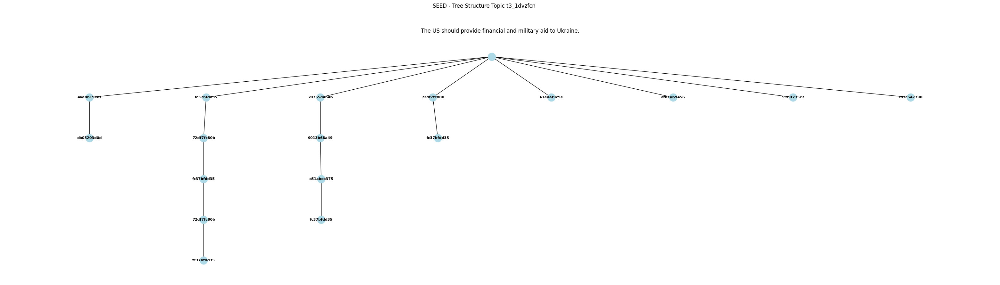

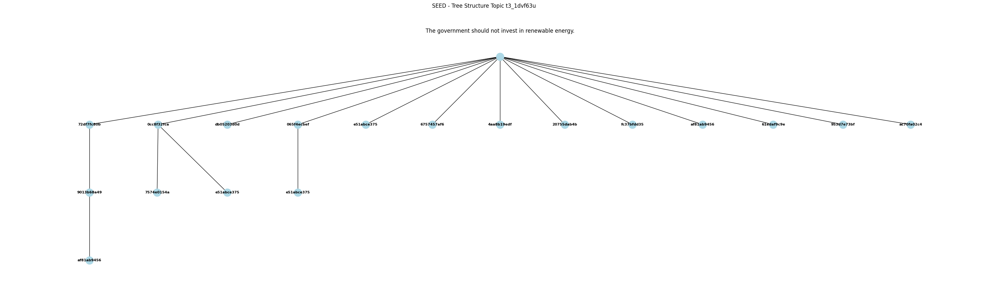

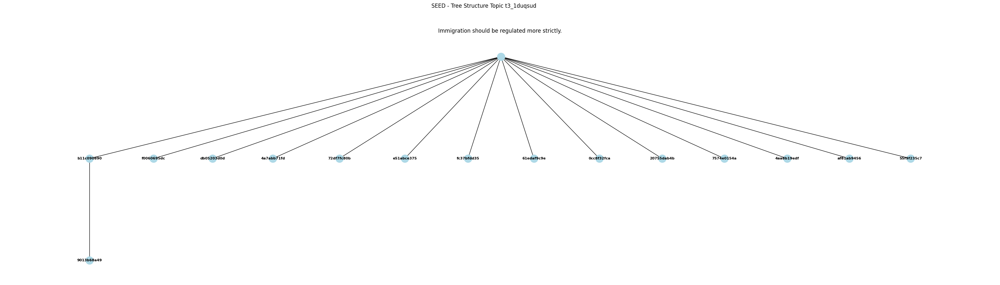

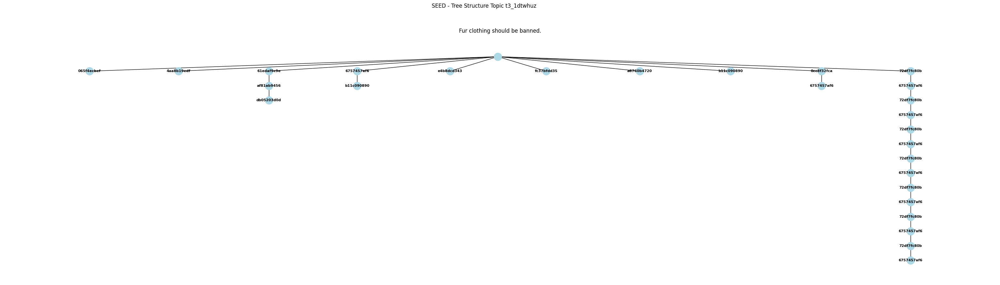

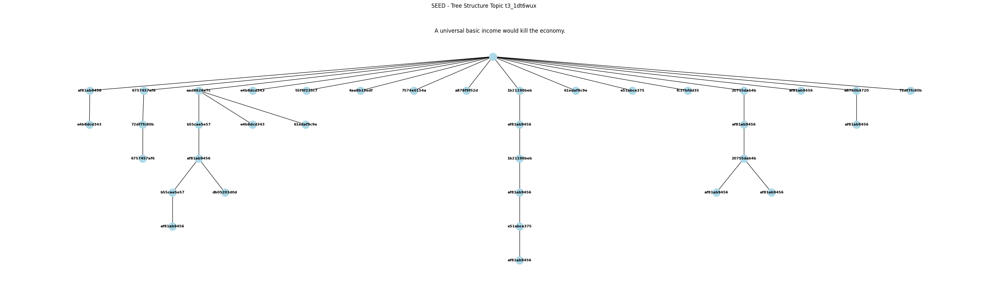

...

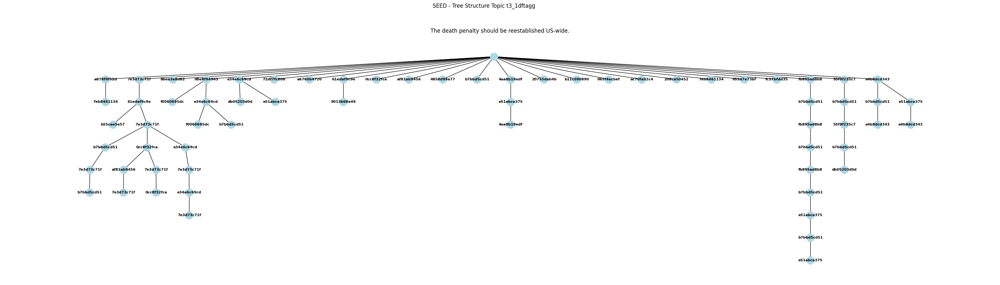

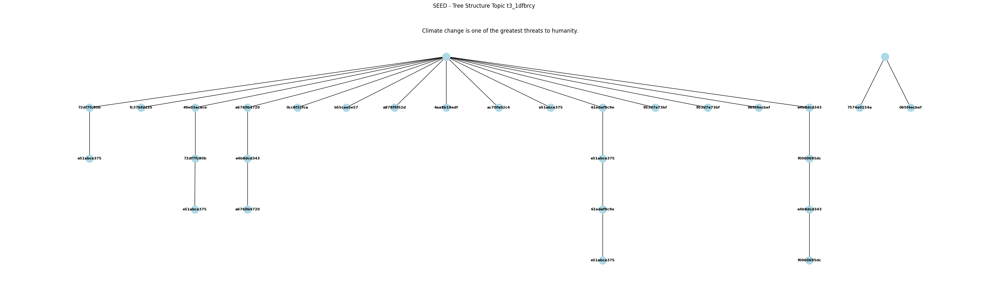

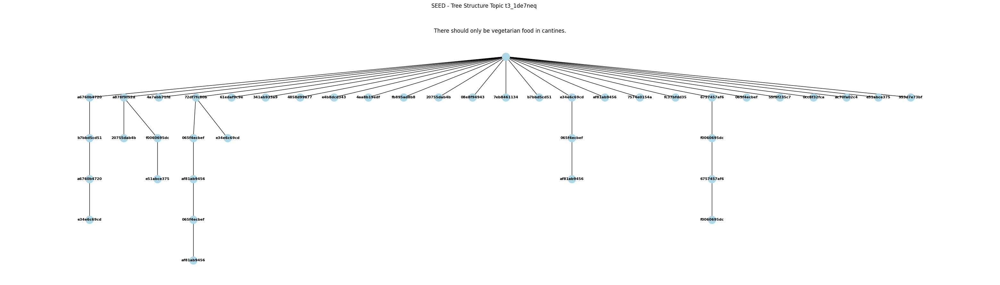

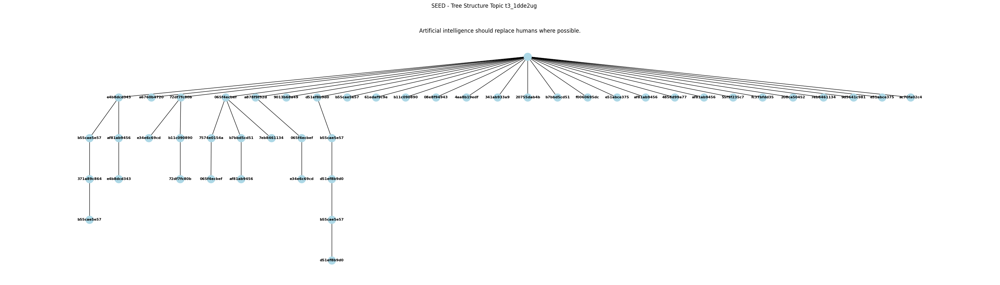

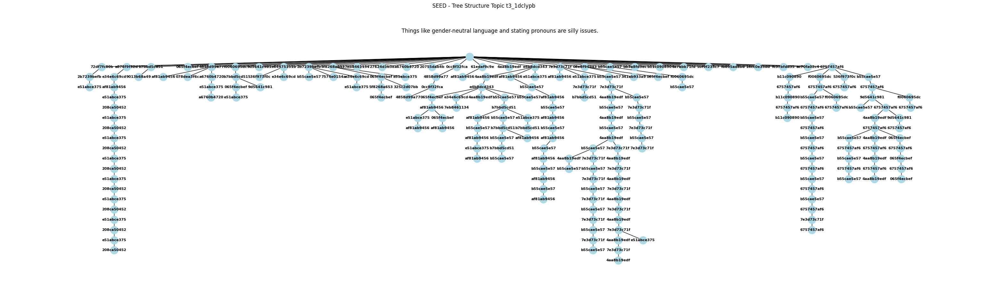

In [8]:
seed_network = {}
for i in simulated_conditions:
    temp = discussions_data[discussions_data["subreddit"] == i]
    seed_network[i] = visualize_thread_tree(temp, data_type="seed", plot=(True if i == 1 else False))

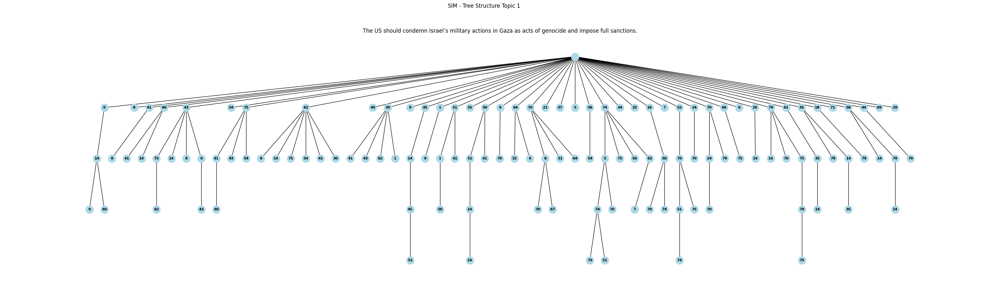

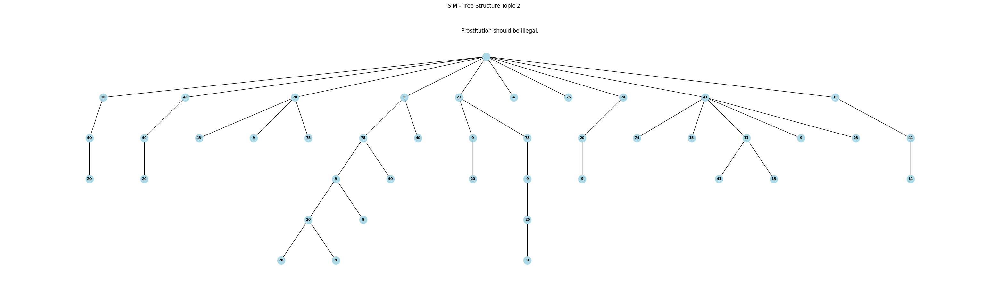

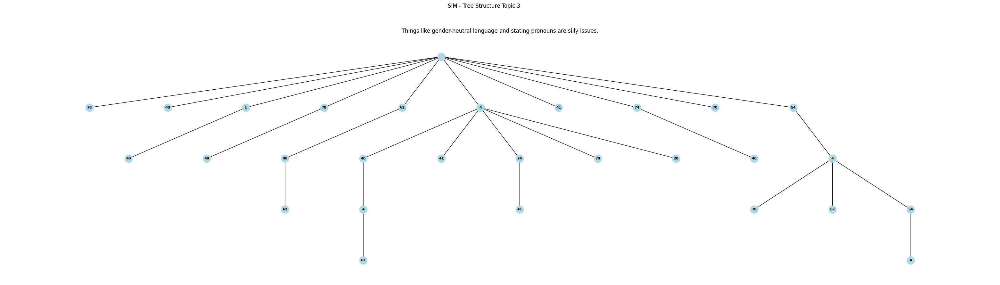

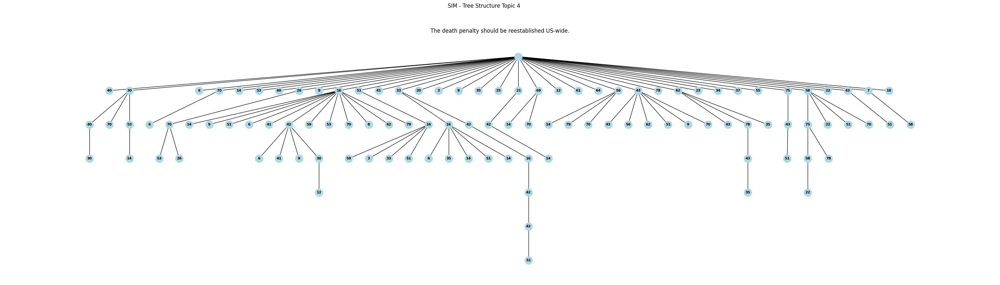

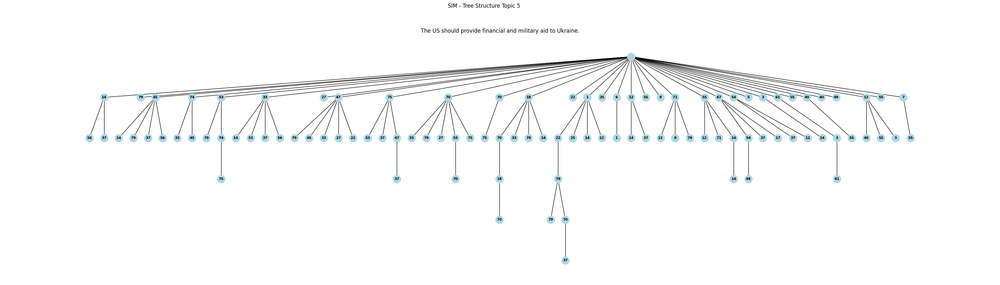

...

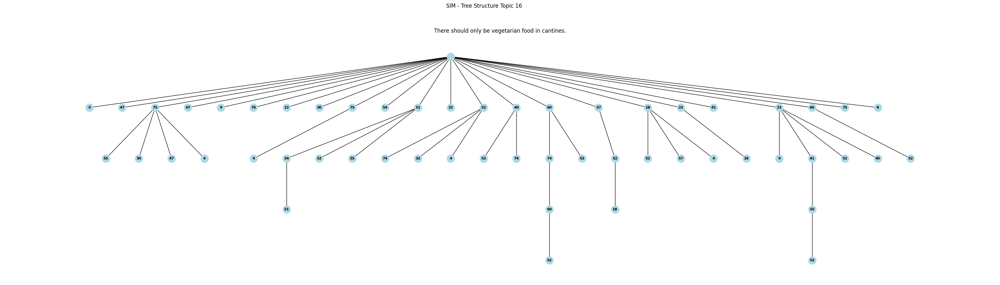

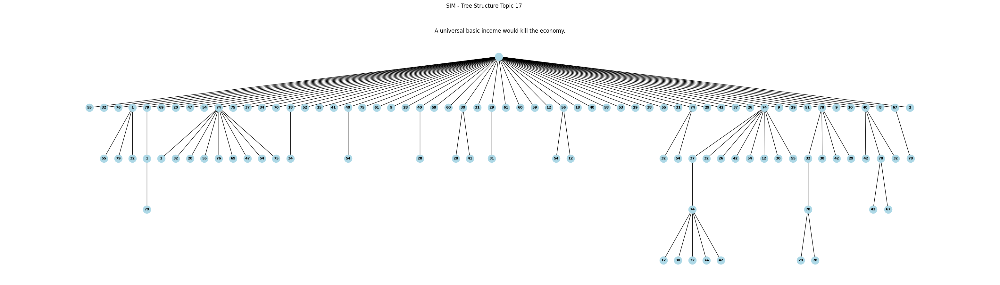

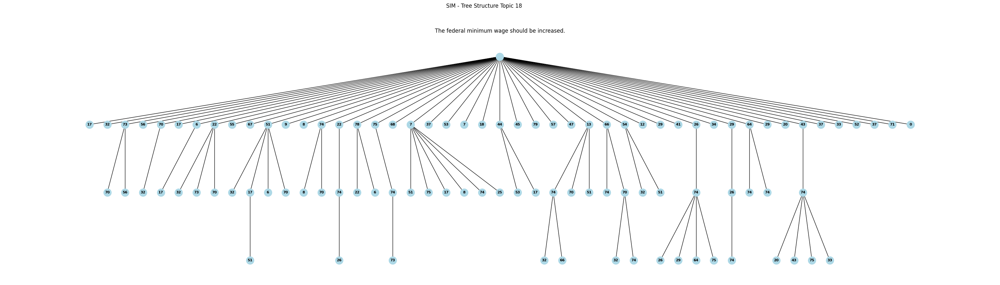

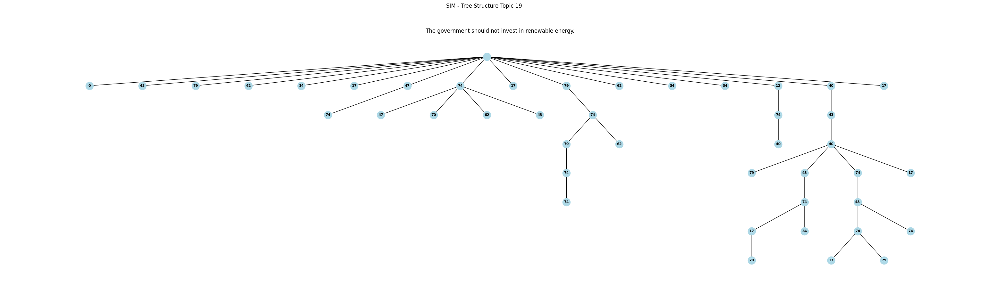

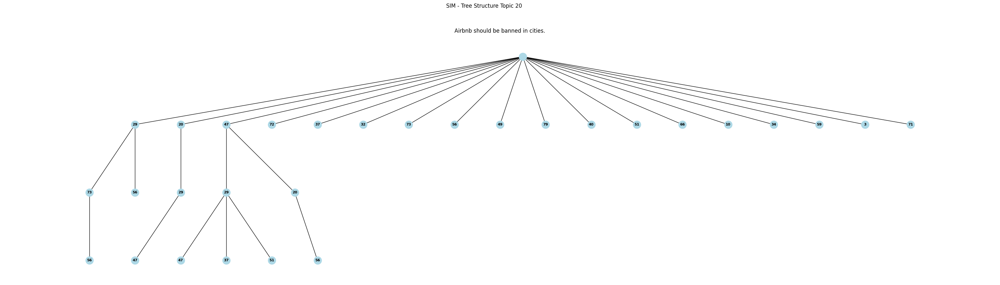

In [9]:
sim_network = {}
for i in simulated_conditions:
    temp = sim_discussions_data[sim_discussions_data["subreddit"] == i]
    sim_network[i] = visualize_thread_tree(temp, data_type="sim", plot=(True if i == 1 else False))

In [10]:
for i in simulated_conditions:
    seed_avg_density = round_mean(seed_network[i]["density"])
    seed_median_density = round_mean(seed_network[i]["density"], mode="median")
    seed_avg_depth = round_mean(seed_network[i]["depth"])
    seed_median_depth = round_mean(seed_network[i]["depth"], mode="median")
    seed_avg_width = round_mean(seed_network[i]["width"])
    seed_median_width = round_mean(seed_network[i]["width"], mode="median")
    
    sim_avg_density = round_mean(sim_network[i]["density"])
    sim_median_density = round_mean(sim_network[i]["density"], mode="median")
    sim_avg_depth = round_mean(sim_network[i]["depth"])
    sim_median_depth = round_mean(sim_network[i]["depth"], mode="median")
    sim_avg_width = round_mean(sim_network[i]["width"])
    sim_median_width = round_mean(sim_network[i]["width"], mode="median")
    
    user_sub_data = user_data[user_data["subreddit"] == i]
    sim_user_sub_data = sim_user_data[sim_user_data["subreddit"] == i]
    seed_active_users = round(len(user_sub_data[user_sub_data["comment_count"] != 0]) / len(user_sub_data), 3)
    sim_active_users = round(len(sim_user_sub_data[sim_user_sub_data["sim_comment_count"] != 0]) / len(sim_user_sub_data), 3)

    discussions_sub_data = discussions_data[discussions_data["subreddit"] == i]
    user_sub_data = user_data[user_data["subreddit"] == i]
    seed_scale_per_topic = discussions_sub_data.groupby("post_title")["ParticipantID"].nunique() 
    seed_n_users_per_sub = user_sub_data["ParticipantID"].nunique()
    seed_active_users_per_topic = seed_scale_per_topic / seed_n_users_per_sub
    seed_active_users_per_topic = seed_active_users_per_topic.reset_index()
    seed_active_users_per_topic.columns = ["topic", "actives"]
    seed_avg_active_users_per_topic = round_mean(seed_active_users_per_topic["actives"])

    sim_discussions_sub_data = sim_discussions_data[sim_discussions_data["subreddit"] == i]
    sim_user_sub_data = sim_user_data[sim_user_data["subreddit"] == i]
    sim_scale_per_topic = sim_discussions_sub_data.groupby("topic")["seed_user_id"].nunique()
    sim_n_users_per_sub = sim_user_sub_data["seed_user_id"].nunique()
    sim_active_users_per_topic = sim_scale_per_topic / sim_n_users_per_sub
    sim_active_users_per_topic = sim_active_users_per_topic.reset_index()
    sim_active_users_per_topic.columns = ["topic", "actives"]
    sim_avg_active_users_per_topic = round_mean(sim_active_users_per_topic["actives"])

    print("#"*50)
    print("{:^50}".format(f"Subreddit {i}"))
    print("#"*50)
    print("{:<30}{:^10}|{:^10}".format("Tree Structure", "Seed", "Sim"))
    print("{:<30}{:^10}|{:^10}".format("Average Degree:", seed_network[i]["avg_degree"], sim_network[i]["avg_degree"]))
    print("{:<30}{:^10}|{:^10}".format("Median Degree:", seed_network[i]["median_degree"], sim_network[i]["median_degree"]))
    print("{:<30}{:^10}|{:^10}".format("Average Density:", seed_avg_density, sim_avg_density))
    print("{:<30}{:^10}|{:^10}".format("Median Density:", seed_median_density, sim_median_density))
    print("{:<30}{:^10}|{:^10}".format("Average Depth:", seed_avg_depth, sim_avg_depth))
    print("{:<30}{:^10}|{:^10}".format("Median Depth:", seed_median_depth, sim_median_depth))
    print("{:<30}{:^10}|{:^10}".format("Average Width:", seed_avg_width, sim_avg_width))
    print("{:<30}{:^10}|{:^10}".format("Median Width:", seed_median_width, sim_median_width))
    print("{:<30}{:^10}|{:^10}".format("% Actives:", seed_active_users, sim_active_users))
    print("{:<30}{:^10}|{:^10}".format("Average % Actives per Sub:", seed_avg_active_users_per_topic, sim_avg_active_users_per_topic))

##################################################
                   Subreddit 1                    
##################################################
Tree Structure                   Seed   |   Sim    
Average Degree:                 1.958   |  1.975   
Median Degree:                   2.0    |   1.0    
Average Density:                0.059   |  0.031   
Median Density:                 0.053   |  0.023   
Average Depth:                   7.5    |   4.75   
Median Depth:                    5.5    |   4.0    
Average Width:                  18.15   |   36.6   
Median Width:                    17.5   |   36.5   
% Actives:                      0.613   |   0.95   
Average % Actives per Sub:      0.263   |  0.354   
##################################################
                   Subreddit 6                    
##################################################
Tree Structure                   Seed   |   Sim    
Average Degree:                 1.936   |   1.98   
Median Degree:    

In [47]:
# Visualize user_network

def visualize_user_network(subreddit_data, data_type, plot=True, save_figs=False):
    if data_type == "seed":
        seed_post_id_col = "post_id"
        parent_id_col = "parent_id"
        user_id_col = "ParticipantID"
        topic_post_content_col = "post_title"
    elif data_type == "sim":
        seed_post_id_col = "topic"
        parent_id_col = "parent_comment_id"
        user_id_col = "user_id"
        topic_post_content_col = "topic_content"
    else:
        raise ValueError("Select either 'seed' or 'sim'.")

    network_metrics = {
        # "triangles_mean": [],
        # "triangles_median": [],
        "transitivity": [],
        "average_clustering": [],
        # "square_clustering": [],
        "n_communities" : []
        }

    for i in list(subreddit_data[topic_post_content_col].drop_duplicates())[:]:
        G = nx.Graph()
        temp = subreddit_data[subreddit_data[topic_post_content_col] == i]
        temp.set_index("comment_id", inplace=True)

        for j, r in temp.iterrows():
            if data_type == "sim":
                if r[parent_id_col] == -1:
                    source = 0
                else:
                    try:
                        source = temp.at[r[parent_id_col], user_id_col]
                    except:
                        source = -1
            else:
                if r[parent_id_col] == r[seed_post_id_col]:
                    source = 0
                else:
                    try:
                        source = temp.at[r[parent_id_col], user_id_col]
                    except:
                        source = -1

            target = r[user_id_col]

            # Increment the weight if the edge already exists
            if G.has_edge(source, target):
                G[source][target]["weight"] += 1
            else:
                G.add_edge(source, target, weight=1)

        # Use a layout algorithm that considers edge weights
        pos = nx.spring_layout(G, weight="weight", k=0.15, iterations=5000)

        # Compute communities using networkx.community.louvain_communities
        communities = nx.community.louvain_communities(G)
        community_dict = {}
        for idx, community in enumerate(communities):
            for node in community:
                community_dict[node] = idx

        node_colors = [community_dict[node] for node in G.nodes()]

        # network_metrics["triangles_mean"].append(np.mean(list(nx.triangles(G).values())))
        # network_metrics["triangles_median"].append(np.median(list(nx.triangles(G).values())))
        network_metrics["transitivity"].append(nx.transitivity(G))
        network_metrics["average_clustering"].append(nx.average_clustering(G))
        # network_metrics["square_clustering"].append(nx.square_clustering(G))
        network_metrics["n_communities"].append(len(communities))

        if plot:
            fig, axs = plt.subplots(1, 1, figsize=(40, 10))
            edges = nx.draw_networkx_edges(G, pos, width=[G[u][v]["weight"] for u, v in G.edges()])
            nodes = nx.draw_networkx_nodes(G, pos, node_size=300, node_color=node_colors, cmap=plt.colormaps["viridis"])
            nx.draw_networkx_labels(G, pos, font_weight="bold", font_size=8)

            plt.suptitle(f"{data_type.upper()} - Tree Structure Topic {i}")
            plt.title(f"{list(temp[topic_post_content_col])[0]}")
            if save_figs:
                plt.savefig(f"figures/{data_type}_networks/{data_type}_topic-{i}_thread-tree.jpg")
            plt.show()

    return network_metrics

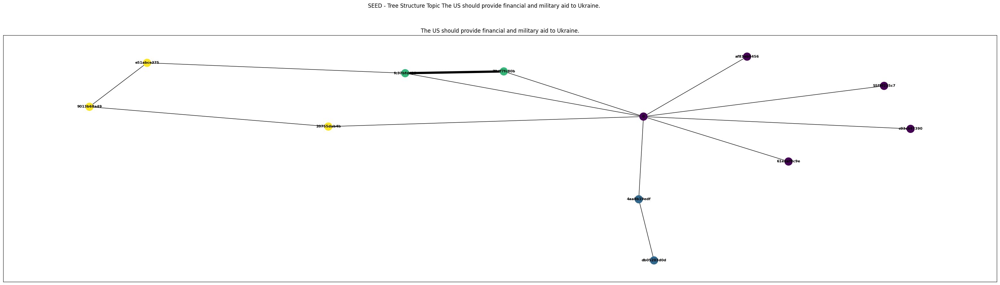

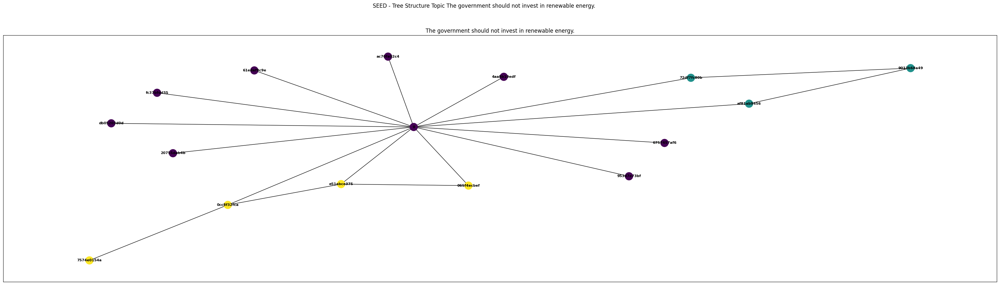

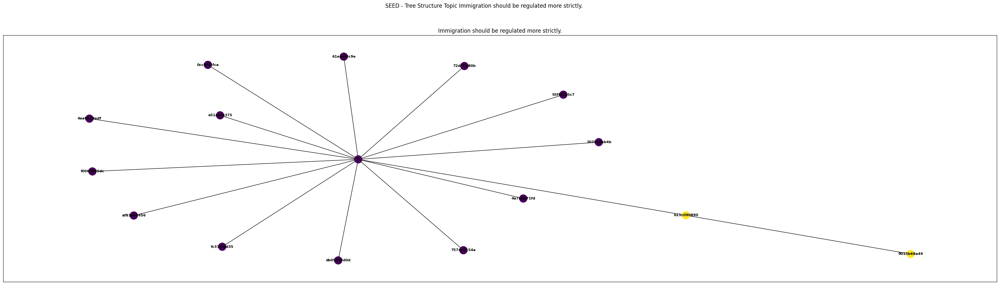

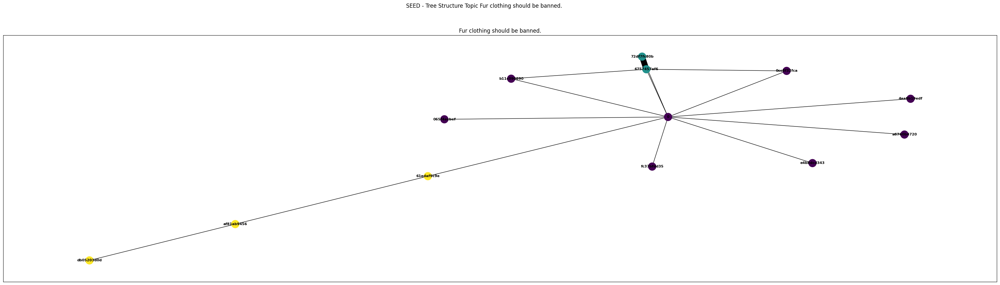

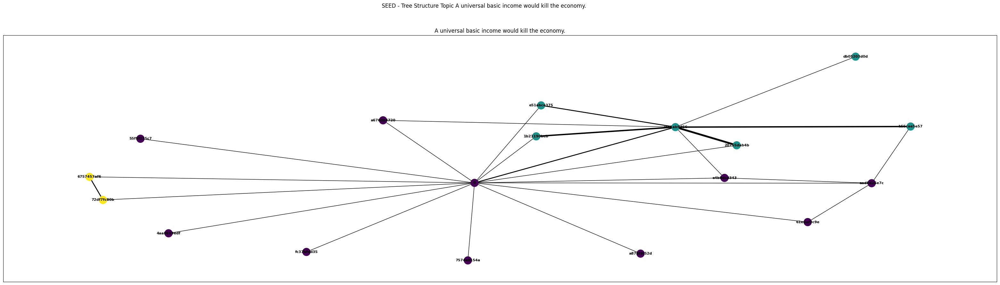

...

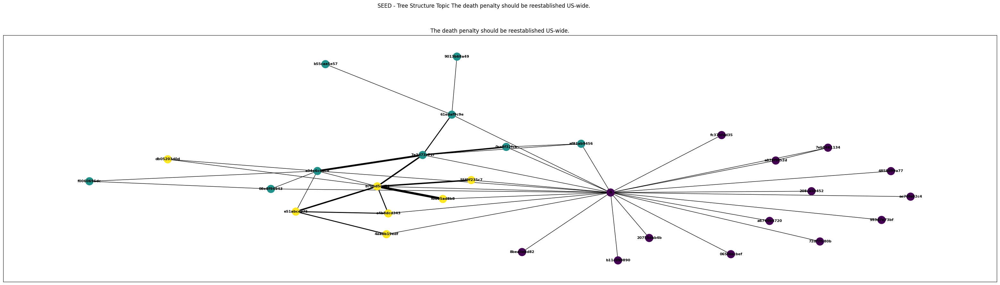

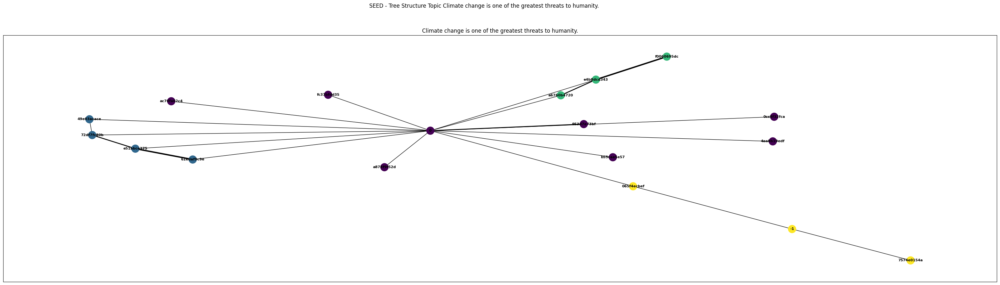

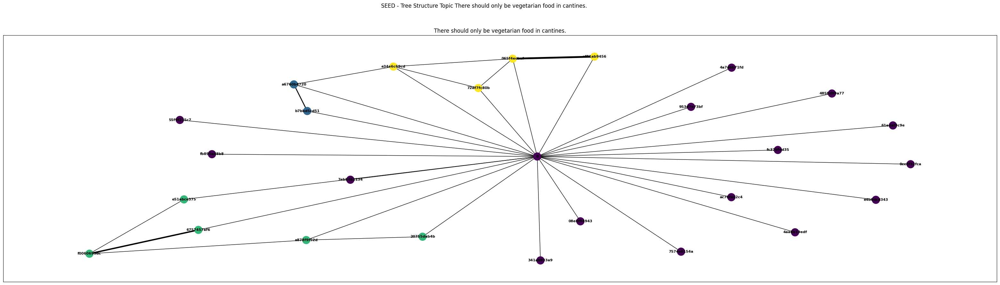

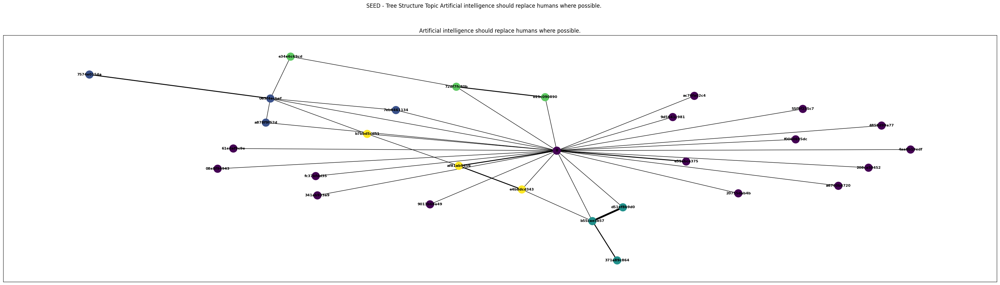

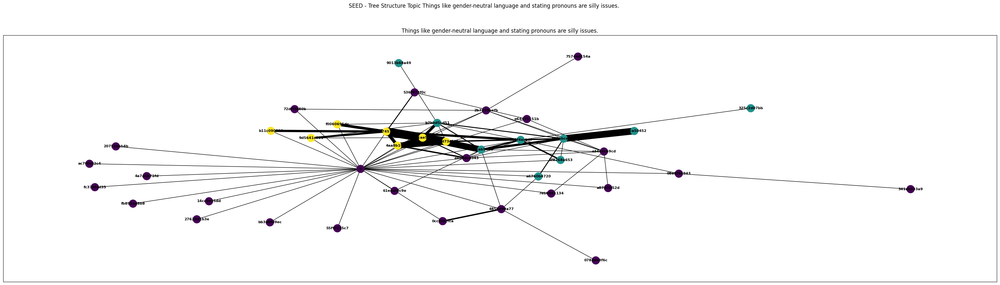

In [48]:
seed_communities = {}
for i in simulated_conditions:
    temp = discussions_data[discussions_data["subreddit"] == i]
    seed_communities[i] = visualize_user_network(temp, data_type="seed", plot=(True if i == 1 else False))

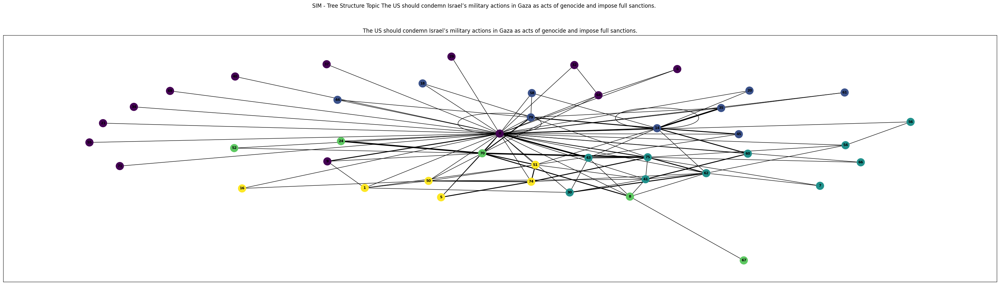

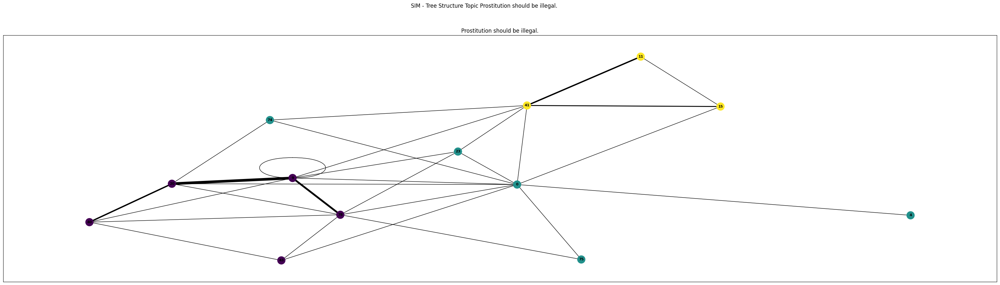

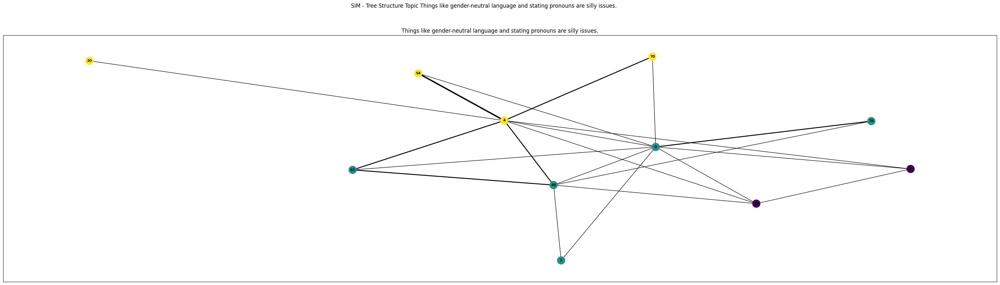

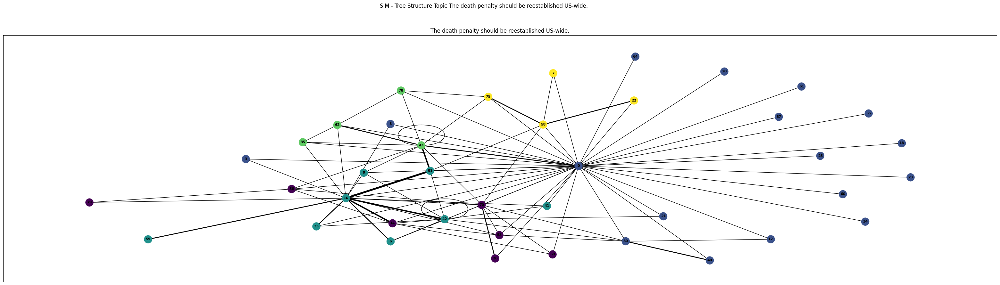

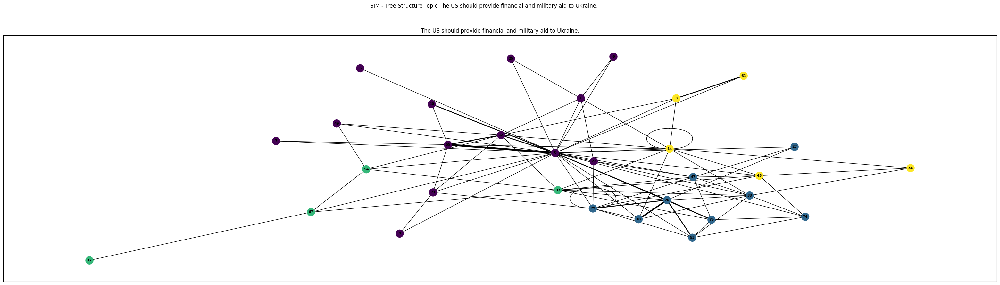

...

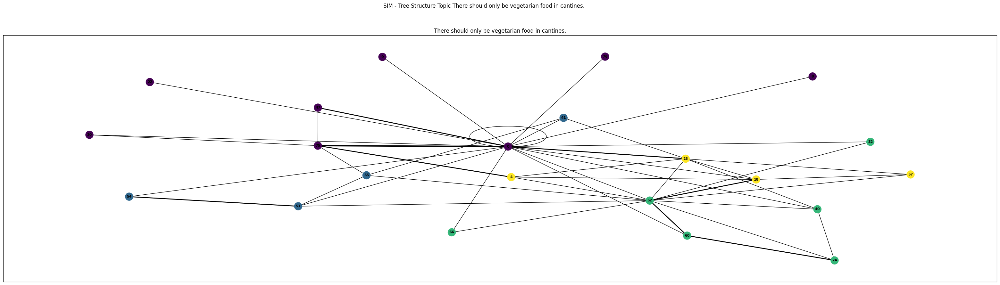

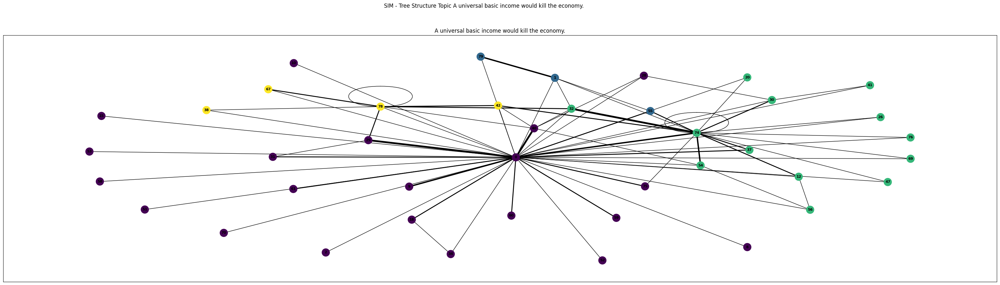

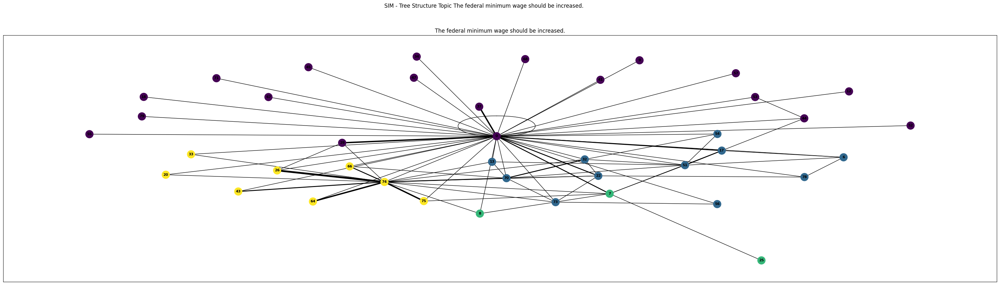

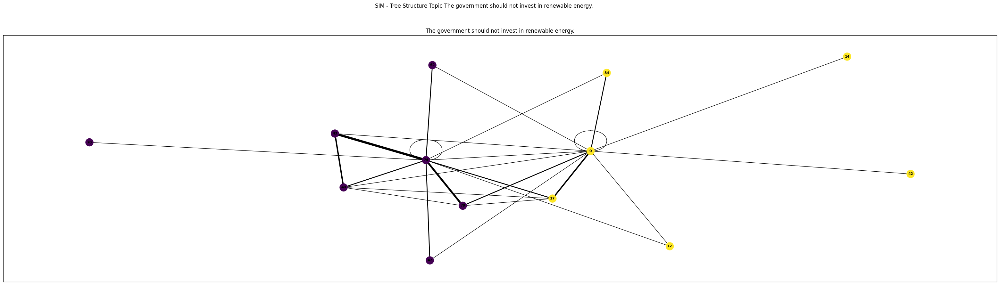

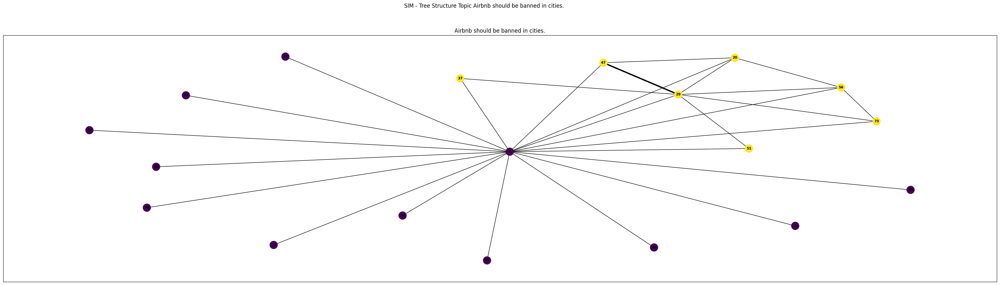

In [49]:
sim_communities = {}
for i in simulated_conditions:
    temp = sim_discussions_data[sim_discussions_data["subreddit"] == i]
    sim_communities[i] = visualize_user_network(temp, data_type="sim", plot=(True if i == 1 else False))

In [118]:
# Summary of interaction network
for i in simulated_conditions:

    seed_mean_transitivity = round_mean(seed_communities[i]["transitivity"])
    seed_median_transitivity = round_mean(seed_communities[i]["transitivity"], "median")
    
    seed_mean_clustering = round_mean(seed_communities[i]["average_clustering"])
    seed_median_clustering = round_mean(seed_communities[i]["average_clustering"], "median")
    
    seed_mean_n_communities = round_mean(seed_communities[i]["n_communities"])
    seed_median_n_communities = round_mean(seed_communities[i]["n_communities"], "median")

    sim_mean_transitivity = round_mean(sim_communities[i]["transitivity"])
    sim_median_transitivity = round_mean(sim_communities[i]["transitivity"], "median")
    
    sim_mean_clustering = round_mean(sim_communities[i]["average_clustering"])
    sim_median_clustering = round_mean(sim_communities[i]["average_clustering"], "median")
    
    sim_mean_n_communities = round_mean(sim_communities[i]["n_communities"])
    sim_median_n_communities = round_mean(sim_communities[i]["n_communities"], "median")
    
    print("#"*50)
    print("{:^50}".format(f"Subreddit {i}"))
    print("#"*50)
    print("{:<30}{:^10}|{:^10}".format("Interaction Network", "Seed", "Sim"))
    print("{:<30}{:^10}|{:^10}".format("Mean Transitivity", seed_mean_transitivity, sim_mean_transitivity))
    print("{:<30}{:^10}|{:^10}".format("Median Transitivity", seed_median_transitivity, sim_median_transitivity))
    print("{:<30}{:^10}|{:^10}".format("Mean Clustering", seed_mean_clustering, sim_mean_clustering))
    print("{:<30}{:^10}|{:^10}".format("Median Clustering", seed_median_clustering, sim_median_clustering))
    print("{:<30}{:^10}|{:^10}".format("Mean N Communities", seed_mean_n_communities, sim_mean_n_communities))
    print("{:<30}{:^10}|{:^10}".format("Median N Communities", seed_median_n_communities, sim_median_n_communities))

##################################################
                   Subreddit 1                    
##################################################
Interaction Network              Seed   |   Sim    
Mean Transitivity                0.12   |  0.269   
Median Transitivity             0.112   |  0.233   
Mean Clustering                 0.232   |  0.539   
Median Clustering               0.237   |  0.531   
Mean N Communities               3.6    |   3.85   
Median N Communities             3.5    |   4.0    
##################################################
                   Subreddit 6                    
##################################################
Interaction Network              Seed   |   Sim    
Mean Transitivity               0.076   |  0.219   
Median Transitivity             0.072   |   0.18   
Mean Clustering                 0.155   |  0.512   
Median Clustering               0.147   |  0.495   
Mean N Communities               4.45   |   4.55   
Median N Communiti

In [90]:
def get_n_replies(data, data_type):
    if data_type == "seed":
        parent_id_col = "parent_id"
        user_id_col = "ParticipantID"
        comment_id_col = "comment_id"
        topic_id_col = "post_id"
        post_ids = list(data[topic_id_col].unique())
    elif data_type == "sim":
        parent_id_col = "parent_comment_id"
        user_id_col = "user_id"
        comment_id_col = "comment_id"
        topic_id_col = "post_id"
        post_ids = [-1]
    else:
        raise ValueError("Enter valid data type")
    
    temp = data.set_index(comment_id_col)
    
    replies = 0
    n_missing_links = 0
    
    for i, r in temp.iterrows():
    
        try:
            if r[parent_id_col] not in post_ids:
                parent = r[parent_id_col]
                user = r[user_id_col]
        
                if temp.at[parent, user_id_col] != user:
                    sup_parent = temp.at[parent, parent_id_col]
        
                    if sup_parent not in post_ids:
                        if temp.at[sup_parent, user_id_col] == user:
                            replies += 1
        except:
            n_missing_links += 1
    
    return replies, n_missing_links

In [113]:
seed_n_replies = []
seed_n_missing_links = []

for i in simulated_conditions:
    sub_temp = discussions_data[discussions_data["subreddit"] == i].sort_values("post_title")
    for j in list(discussions_data["post_title"].unique()):
        topic_temp = sub_temp[sub_temp["post_title"] == j]
        topic_data = get_n_replies(topic_temp, "seed")

        # print(topic_data)
        seed_n_replies.append(topic_data[0])
        seed_n_missing_links.append(topic_data[1])

In [116]:
sim_n_replies = []
sim_n_missing_links = []

for i in simulated_conditions:
    sub_temp = sim_discussions_data[sim_discussions_data["subreddit"] == i].sort_values("topic_content")
    for j in list(sim_discussions_data["topic"].unique()):
        topic_temp = sub_temp[sub_temp["topic"] == j]
        topic_data = get_n_replies(topic_temp, "sim")

        # print(topic_data)
        sim_n_replies.append(topic_data[0])
        sim_n_missing_links.append(topic_data[1])

In [124]:
list(range(0, len(seed_n_replies)+1, 20))

[0, 20, 40]

In [127]:
# Summary of reply patterns

seed_mean_n_replies = round_mean(seed_n_replies)
seed_median_n_replies = round_mean(seed_n_replies, "median")

sim_mean_n_replies = round_mean(sim_n_replies)
sim_median_n_replies = round_mean(sim_n_replies, "median")

print("{:<30}{:^10}|{:^10}".format("Interaction Network", "Seed", "Sim"))
print("{:<30}{:^10}|{:^10}".format("Mean N Replies", seed_mean_n_replies, sim_mean_n_replies))
print("{:<30}{:^10}|{:^10}".format("Median N Replies", seed_median_n_replies, sim_median_n_replies))

for i, j in zip(range(len(simulated_conditions)), simulated_conditions):

    bounds = list(range(0, len(seed_n_replies)+1, 20))

    seed_mean_n_replies_sub = round_mean(seed_n_replies[bounds[i]:bounds[i+1]])
    seed_median_n_replies_sub = round_mean(seed_n_replies[bounds[i]:bounds[i+1]], "median")

    sim_mean_n_replies_sub = round_mean(sim_n_replies[bounds[i]:bounds[i+1]])
    sim_median_n_replies_sub = round_mean(sim_n_replies[bounds[i]:bounds[i+1]], "median")
    
    print("#"*50)
    print("{:^50}".format(f"Subreddit {j}"))
    print("#"*50)
    print("{:<30}{:^10}|{:^10}".format("Interaction Network", "Seed", "Sim"))
    print("{:<30}{:^10}|{:^10}".format("Mean N Replies", seed_mean_n_replies_sub, sim_mean_n_replies_sub))
    print("{:<30}{:^10}|{:^10}".format("Median N Replies", seed_median_n_replies_sub, sim_median_n_replies_sub))

Interaction Network              Seed   |   Sim    
Mean N Replies                  14.15   |   4.15   
Median N Replies                 8.0    |   3.0    
##################################################
                   Subreddit 1                    
##################################################
Interaction Network              Seed   |   Sim    
Mean N Replies                  16.45   |   4.25   
Median N Replies                 6.0    |   3.5    
##################################################
                   Subreddit 6                    
##################################################
Interaction Network              Seed   |   Sim    
Mean N Replies                  11.85   |   4.05   
Median N Replies                 11.5   |   3.0    


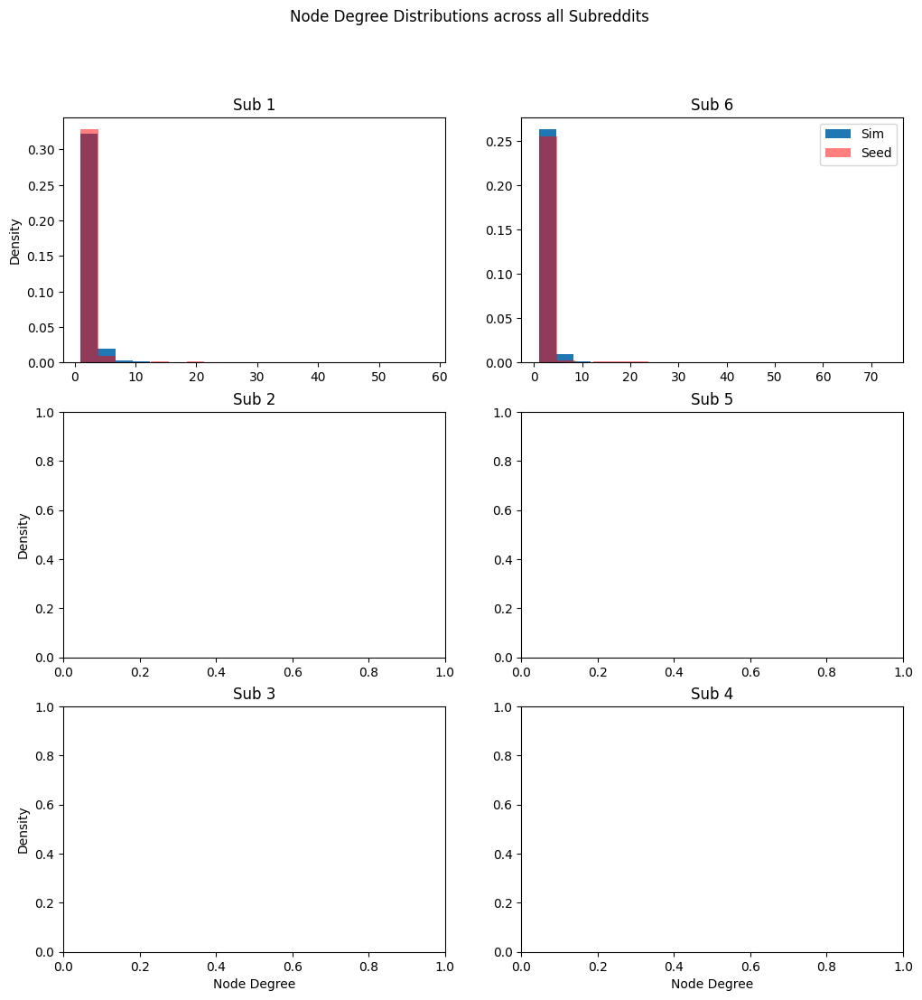

In [12]:
fig, axs = plt.subplots(3, 2, figsize=(12, 12))

axs[0][0].hist([i for j in sim_network[1]["degrees"] for i in j], density=True, bins=20, label="Sim")
axs[0][0].hist([i for j in seed_network[1]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[0][0].set_title("Sub 1")
axs[0][0].set_ylabel("Density")

axs[0][1].hist([i for j in sim_network[6]["degrees"] for i in j], density=True, bins=20, label="Sim")
axs[0][1].hist([i for j in seed_network[6]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[0][1].set_title("Sub 6")
axs[0][1].legend()

# axs[1][0].hist([i for j in sim_network[2]["degrees"] for i in j], density=True, bins=20, label="Sim")
# axs[1][0].hist([i for j in seed_network[2]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[1][0].set_title("Sub 2")
axs[1][0].set_ylabel("Density")

# axs[1][1].hist([i for j in sim_network[5]["degrees"] for i in j], density=True, bins=20, label="Sim")
# axs[1][1].hist([i for j in seed_network[5]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[1][1].set_title("Sub 5")

# axs[2][0].hist([i for j in sim_network[3]["degrees"] for i in j], density=True, bins=20, label="Sim")
# axs[2][0].hist([i for j in seed_network[3]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[2][0].set_title("Sub 3")
axs[2][0].set_xlabel("Node Degree")
axs[2][0].set_ylabel("Density")

# axs[2][1].hist([i for j in sim_network[4]["degrees"] for i in j], density=True, bins=20, label="Sim")
# axs[2][1].hist([i for j in seed_network[4]["degrees"] for i in j], density=True, color="r", alpha=0.5, label="Seed")
axs[2][1].set_title("Sub 4")
axs[2][1].set_xlabel("Node Degree")

plt.suptitle("Node Degree Distributions across all Subreddits")
if save_figs:
    plt.savefig("figures/seed-sim_dist_node-degrees-per-sub.jpg")
plt.show()

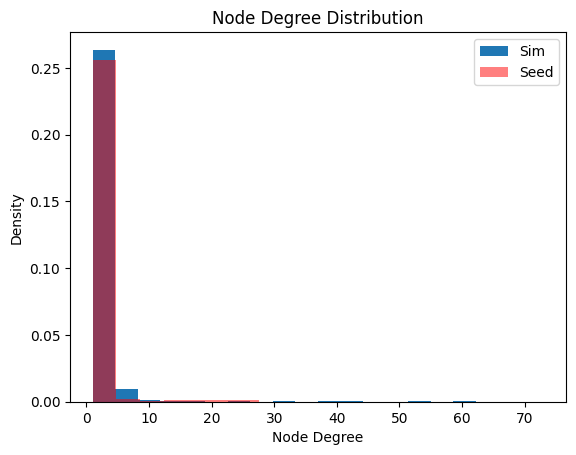

In [142]:
seed_temp = []
sim_temp = []

for i in simulated_conditions:
    seed_temp.extend([j for k in seed_network[i]["degrees"] for j in k])
    sim_temp.extend([j for k in sim_network[i]["degrees"] for j in k])

plt.hist(sim_temp, density=True, label="Sim", bins=20)
plt.hist(seed_temp, density=True, color="r", alpha=0.5, label="Seed")
plt.xlabel("Node Degree")
plt.ylabel("Density")
plt.legend()
plt.title("Node Degree Distribution")
if save_figs:
    plt.savefig("figures/seed-sim_dist_node-degrees.jpg")
plt.show()

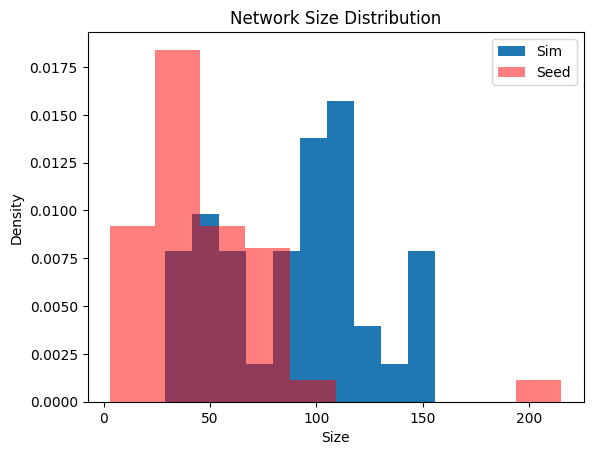

In [14]:
seed_temp = []
sim_temp = []

for i in simulated_conditions:
    seed_temp.extend(seed_network[i]["size"])
    sim_temp.extend(sim_network[i]["size"])

plt.hist(sim_temp, density=True, label="Sim")
plt.hist(seed_temp, density=True, color="r", alpha=0.5, label="Seed")
plt.xlabel("Size")
plt.ylabel("Density")
plt.legend()
plt.title("Network Size Distribution")
if save_figs:
    plt.savefig("figures/seed-sim_dist_network-size.jpg")
plt.show()

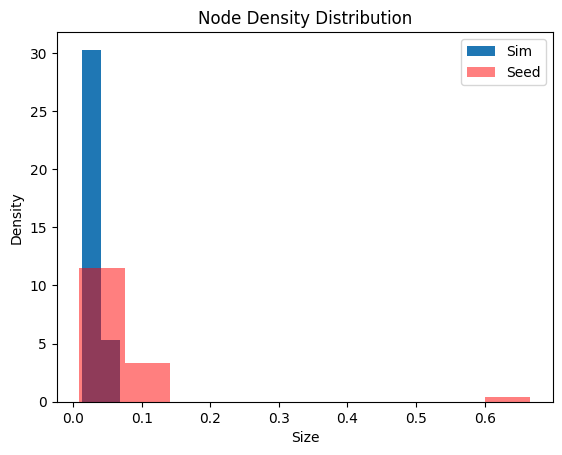

In [140]:
seed_temp = []
sim_temp = []

for i in simulated_conditions:
    seed_temp.extend(seed_network[i]["density"])
    sim_temp.extend(sim_network[i]["density"])

plt.hist(sim_temp, density=True, label="Sim", bins=2)
plt.hist(seed_temp, density=True, color="r", alpha=0.5, label="Seed")
plt.xlabel("Size")
plt.ylabel("Density")
plt.legend()
plt.title("Node Density Distribution")
if save_figs:
    plt.savefig("figures/seed-sim_dist_node-density.jpg")
plt.show()

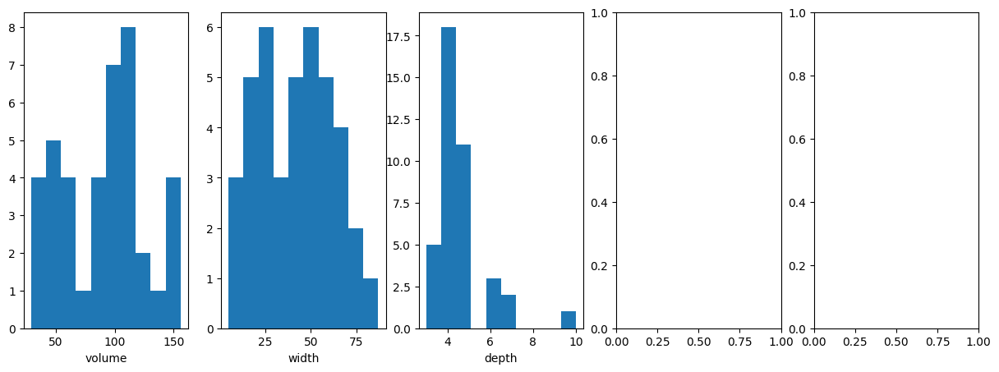

In [16]:
# Plot simulation descriptives
fig, axs = plt.subplots(1, 5, figsize=(15, 5))

axs[0].hist([i for j in [sim_network[k]["size"] for k in simulated_conditions] for i in j])
axs[0].set_xlabel("volume")

axs[1].hist([i for j in [sim_network[k]["width"] for k in simulated_conditions] for i in j])
axs[1].set_xlabel("width")

axs[2].hist([i for j in [sim_network[k]["depth"] for k in simulated_conditions] for i in j])
axs[2].set_xlabel("depth")

# axs[3].hist(process_plot_data(structure_data, "scale"))
# axs[3].set_xlabel("scale")

# axs[4].hist(process_plot_data(structure_data, "active"))
# axs[4].set_xlabel("active")

if save_figs:
    plt.savefig("figures/sim_descriptives.jpg")
plt.show()

1897


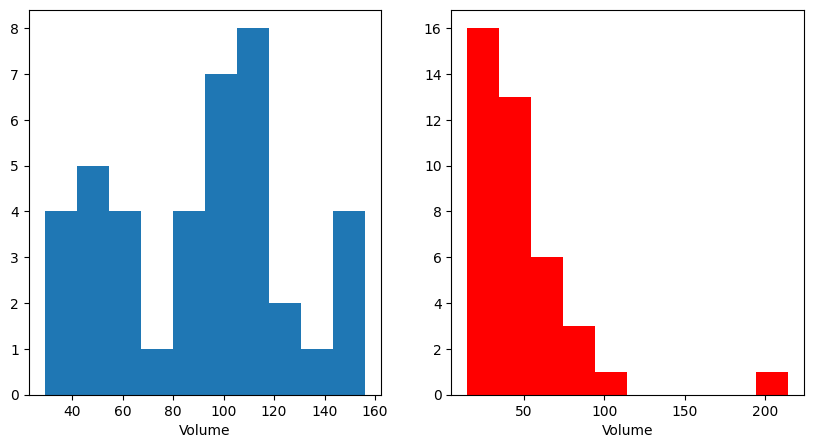

In [17]:
# Plot dist of volume across sim and seed threads
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].hist([i for j in [sim_network[k]["size"] for k in simulated_conditions] for i in j])
axs[0].set_xlabel("Volume")

temp = discussions_data.groupby(["subreddit", "post_title"]).count()["comment_id"]

print(discussions_data.groupby([
    "subreddit", "post_title"
]).count()["ParticipantID"].sum())

axs[1].hist(temp, color="r", label="Seed")
axs[1].set_xlabel("Volume")

# plt.legend()
if save_figs:
    plt.savefig("figures/seed-sim_vol.jpg")
plt.show()

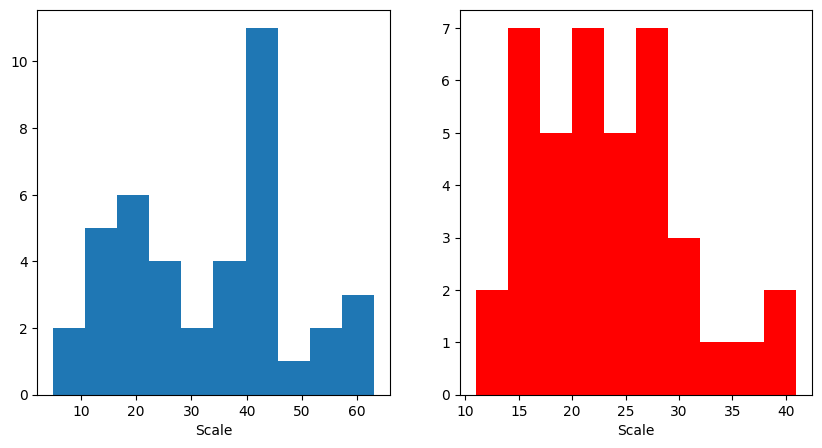

In [18]:
# Plot dist of scale across sim and seed threads
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

sim_temp = sim_discussions_data.groupby([
    "subreddit", "topic"
]).nunique("seed_user_id")

axs[0].hist(sim_temp["seed_user_id"], label="SIM")
axs[0].set_xlabel("Scale")

temp = discussions_data.groupby([
    "subreddit", "post_title"
]).nunique("ParticipantID")

axs[1].hist(temp["ParticipantID"], color="r", label="Seed")
axs[1].set_xlabel("Scale")

# plt.legend()
if save_figs:
    plt.savefig("figures/seed-sim_dist_scale.jpg")
plt.show()

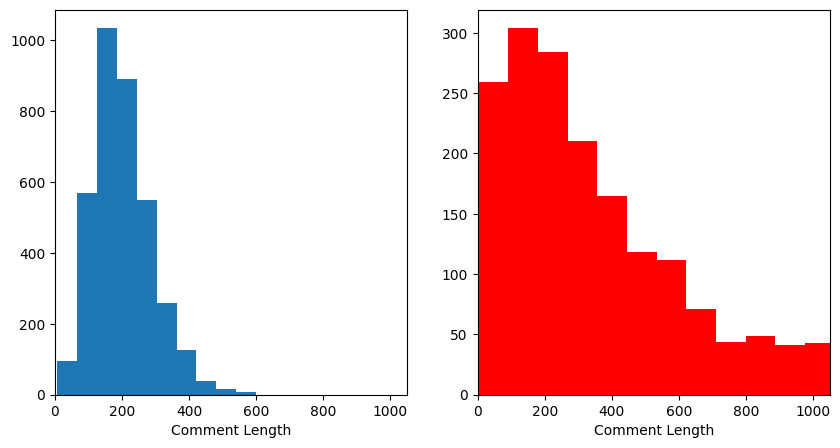

In [19]:
# Plot dist of comment lengths for all Sims
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].hist(sim_discussions_data["sim_comment_length"], label="Sim")

axs[0].set_xlabel("Comment Length")
axs[0].set_xlim(0, 1050)

axs[1].hist(
    discussions_data["length_comment_char"], color="r", bins=60, label="Seed"
)
axs[1].set_xlabel("Comment Length")
axs[1].set_xlim(0, 1050)

# plt.legend()
if save_figs:
    plt.savefig("figures/seed-sim_dist_comment-lengths.jpg")
plt.show()

In [131]:
# Plot correct?!
max(sim_discussions_data["sim_comment_length"])

600

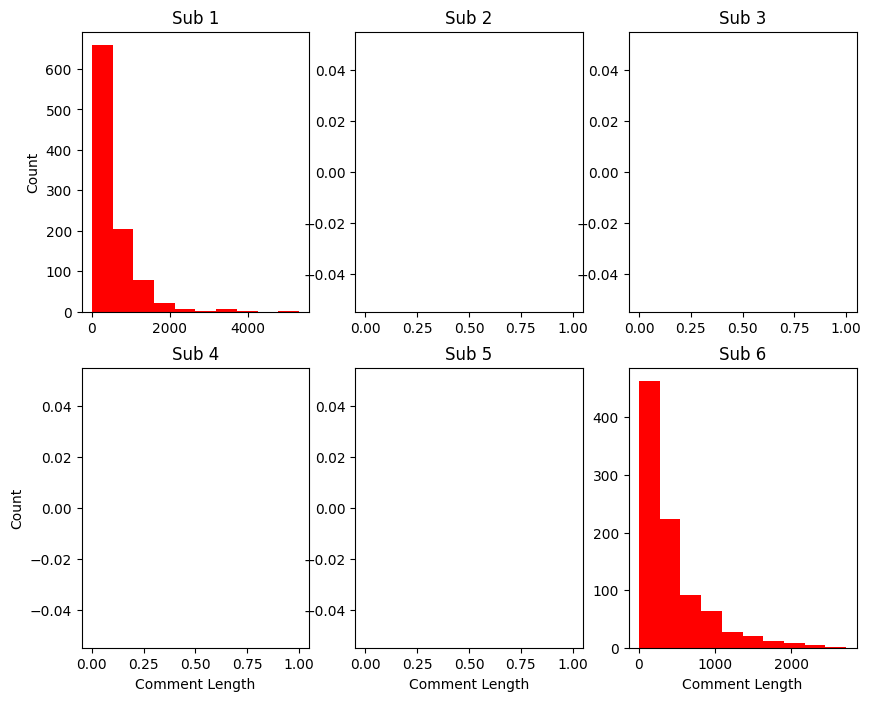

In [20]:
# Plot dist of comment lengths for all Sims
fig, axs = plt.subplots(2, 3, figsize=(10, 8))
k = 1
for i in range(2):
    for j in range(3):
        temp = discussions_data.loc[discussions_data["subreddit"] == (i+1)*(j+1)]
        axs[i][j].hist(
            temp["length_comment_char"], color="r", label="Seed"
        )
        axs[i][j].set_title(f"Sub {k}")
        if i > 0:
            axs[i][j].set_xlabel("Comment Length")
        # axs[i][j].set_xlim(0, 2000)
        if j == 0 or j == 3:
            axs[i][j].set_ylabel("Count")
        k += 1

# plt.legend()
if save_figs:
    plt.savefig("figures/seed_dist_sub-comment-lengths.jpg")
plt.show()

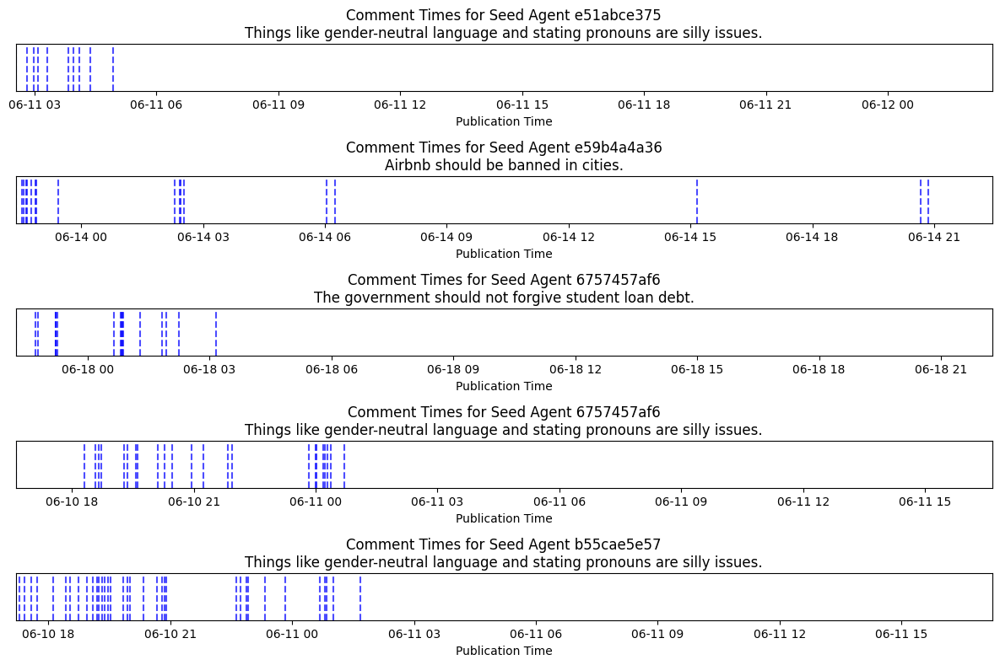

In [21]:
# Seed
temp = discussions_data.groupby(["ParticipantID", "post_title"]).size().sort_values().tail(5)

j = 0
fig, axs = plt.subplots(5, 1, figsize=(12, 8))
for i, r in temp.items():
    comments = discussions_data[
    discussions_data["ParticipantID"] == i[0]
    ]
    comments = comments[comments["post_title"] == i[1]][
    "created_comment"
    ]
    
    for comment in pd.to_datetime(comments):
        axs[j].axvline(x=comment, color="b", linestyle="--", alpha=0.7)
    
    # axs[j].set_xlim([pd.to_datetime(comments).min() - pd.Timedelta(minutes=1),
    #              pd.to_datetime(comments).max() + pd.Timedelta(minutes=1)])
    axs[j].set_xlim([pd.to_datetime(comments).min() - pd.Timedelta(minutes=1),
                 pd.to_datetime(comments).min() + pd.Timedelta(hours=24, minutes=1)])
    # axs[j].set_ylim([0, 0.9])
    axs[j].set_title(f"Comment Times for Seed Agent {i[0]}\n{i[1]}")
    axs[j].set_xlabel("Publication Time")

    axs[j].set_yticks([])

    j += 1

plt.tight_layout()
if save_figs:
    plt.savefig("figures/seed_top-5_burst.jpg")
plt.show()

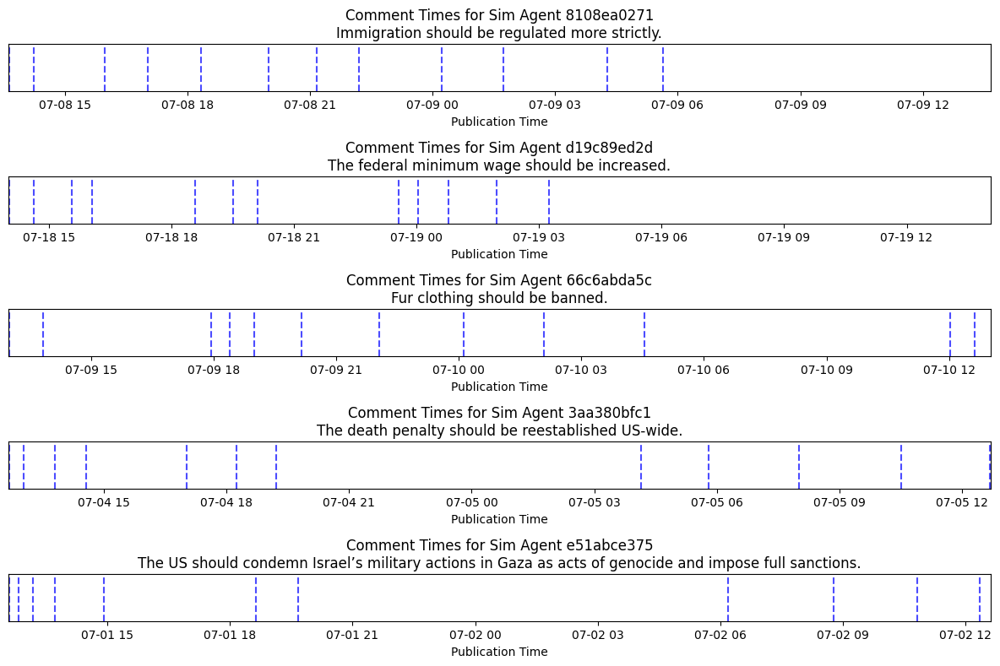

In [22]:
# SIM
temp = sim_discussions_data.groupby(["seed_user_id", "topic_content"]).size().sort_values().tail(5)

j = 0
fig, axs = plt.subplots(5, 1, figsize=(12, 8))
for i, r in temp.items():
    comments = sim_discussions_data[
    sim_discussions_data["seed_user_id"] == i[0]
    ]
    comments = comments[comments["topic_content"] == i[1]][
    "created_at"
    ]
    
    for comment in pd.to_datetime(comments):
        axs[j].axvline(x=comment, color="b", linestyle="--", alpha=0.7)
    
    # axs[j].set_xlim([pd.to_datetime(comments).min() - pd.Timedelta(minutes=1),
    #              pd.to_datetime(comments).max() + pd.Timedelta(minutes=1)])
    axs[j].set_xlim([pd.to_datetime(comments).min() - pd.Timedelta(minutes=1),
                 pd.to_datetime(comments).min() + pd.Timedelta(hours=24, minutes=1)])
    # axs[j].set_ylim([0, 0.9])
    axs[j].set_title(f"Comment Times for Sim Agent {i[0]}\n{i[1]}")
    axs[j].set_xlabel("Publication Time")

    axs[j].set_yticks([])

    j += 1

plt.tight_layout()
if save_figs:
    plt.savefig("figures/sim_top-5_burst.jpg")
plt.show()

In [23]:
# Determine intial activation prob
k = 0
n = 24
ps = [
    0.0025,
    0.00325,
    0.015, 
    0.05, 
    0.1
]

for p in ps:
    print(f"Min. {k+1} over {n}({p})", round(scipy.stats.binom.sf(k, n, p), 3))

Min. 1 over 24(0.0025) 0.058
Min. 1 over 24(0.00325) 0.075
Min. 1 over 24(0.015) 0.304
Min. 1 over 24(0.05) 0.708
Min. 1 over 24(0.1) 0.92


In [181]:
# Function to help remove outliers via IQR
# def get_quartiles(data):
#     q1 = np.percentile(data, 25)
#     q3 = np.percentile(data, 75)
#     iqr = q3 - q1
#     lb = q1 - 1.5*iqr
#     ub = q3 + 1.5*iqr
#     return lb, ub

In [103]:
# Visualize Seed activation probability function
discussions_data["created_comment"] = pd.to_datetime(
    discussions_data["created_comment"]
)
discussions_data["interevent_diff"] = discussions_data.sort_values(
    ["ParticipantID", "created_comment"]
).groupby("ParticipantID")["created_comment"].diff().dt.total_seconds()

temp = discussions_data.copy()
temp = temp[temp["subreddit"].isin(simulated_conditions)]

# Intital posts not preceeded by another post hold NA value for ie_diff
seed_ie_total_posts = len(temp)
seed_ie_initial_posts = temp["interevent_diff"].isna().sum()
seed_ie_posts = seed_ie_total_posts - seed_ie_initial_posts
temp.dropna(subset=["interevent_diff"], inplace=True)
temp = temp[temp["interevent_diff"] != 0.0]
# remove outliers
# temp = temp[temp["interevent_diff"] <= get_quartiles(
#     temp["interevent_diff"]
# )[1]]
temp = temp["interevent_diff"].sort_values()
seed_ie_posts_outlier_corrected = len(temp)
seed_ie_posts_outlier_share = round((seed_ie_posts - seed_ie_posts_outlier_corrected) / seed_ie_posts, 3)
ie_times_seed = temp

In [104]:
# Visualize SIM activation probability function
sim_discussions_data["created_at"] = pd.to_datetime(
    sim_discussions_data["created_at"]
)
sim_discussions_data["interevent_diff"] = sim_discussions_data.sort_values(
    ["seed_user_id", "created_at"]
).groupby("seed_user_id")["created_at"].diff().dt.total_seconds()

temp = sim_discussions_data.copy()
temp = temp[temp["subreddit"].isin(simulated_conditions)]

# Intital posts not preceeded by another post hold NA value for ie_diff
sim_ie_total_posts = len(temp)
sim_ie_initial_posts = temp["interevent_diff"].isna().sum()
sim_ie_posts = sim_ie_total_posts - sim_ie_initial_posts
temp.dropna(subset=["interevent_diff"], inplace=True)
temp = temp[temp["interevent_diff"] != 0.0]
# remove outliers
# temp = temp[temp["interevent_diff"] <= get_quartiles(
#     temp["interevent_diff"]
# )[1]]
temp = temp["interevent_diff"].sort_values()
sim_ie_posts_outlier_corrected = len(temp)
sim_ie_posts_outlier_share = round((sim_ie_posts - sim_ie_posts_outlier_corrected) / sim_ie_posts, 3)
ie_times_sim = temp

In [59]:
print("#"*50)
print("{:<30}{:^10}|{:^10}".format("Interevent Data", "Seed", "Sim"))
print("#"*50)
print("{:<30}{:^10}|{:^10}".format("Total Posts:", seed_ie_total_posts, sim_ie_total_posts))
print("{:<30}{:^10}|{:^10}".format("Initial Posts:", seed_ie_initial_posts, sim_ie_initial_posts))
print("{:<30}{:^10}|{:^10}".format("IE Posts:", seed_ie_posts, sim_ie_posts))
print("{:<30}{:^10}|{:^10}".format("IE Posts (Outlier adjusted):", seed_ie_posts_outlier_corrected, sim_ie_posts_outlier_corrected))
print("{:<30}{:^10}|{:^10}".format("IE Posts % Outliers:", seed_ie_posts_outlier_share, sim_ie_posts_outlier_share))

##################################################
Interevent Data                  Seed   |   Sim    
##################################################
Total Posts:                     1897   |   3576   
Initial Posts:                   114    |   171    
IE Posts:                        1783   |   3405   
IE Posts (Outlier adjusted):     1783   |   3405   
IE Posts % Outliers:             0.0    |   0.0    


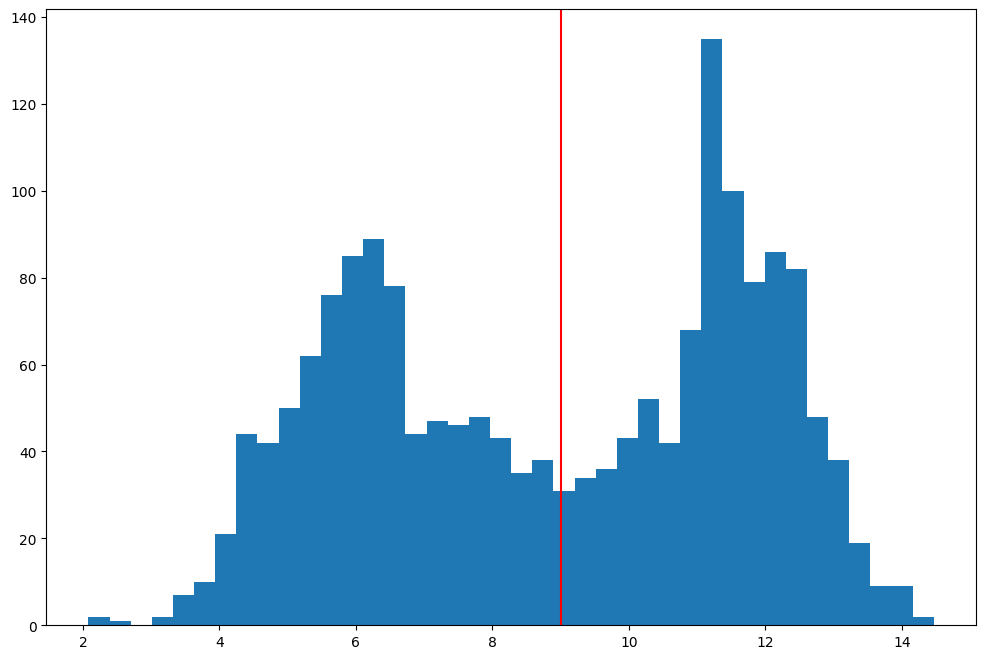

In [60]:
fig, ax = plt.subplots(1,1, figsize=(12, 8))

ax.hist(np.log(discussions_data["interevent_diff"]), bins=40)
ax.axvline(9, color="r")

if save_figs:
    plt.savefig("figures/seed_log-ie-dist.jpg")
plt.show()

In [91]:
# temp = discussions_data[~discussions_data["interevent_diff"].isna()]
temp = discussions_data.copy()

intraevent_data = temp[temp["interevent_diff"] <= np.exp(9)]
interevent_data = temp[temp["interevent_diff"] > np.exp(9)]

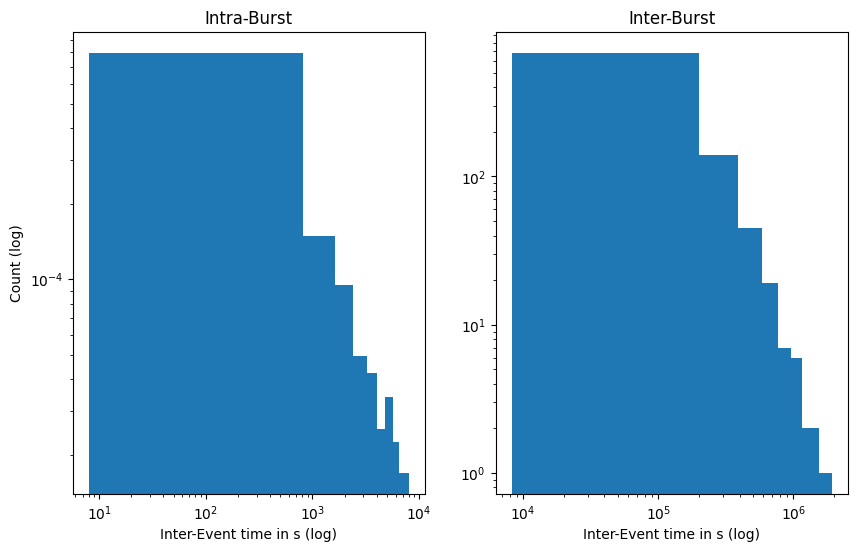

In [92]:
fig, axs = plt.subplots(1, 2, figsize=(10,6))

axs[0].hist(intraevent_data["interevent_diff"], density=True)
axs[1].hist(interevent_data["interevent_diff"])

axs[0].set_title("Intra-Burst")
axs[0].set_xscale("log")
axs[0].set_xlabel("Inter-Event time in s (log)")
axs[0].set_yscale("log")
axs[0].set_ylabel("Count (log)")

axs[1].set_title("Inter-Burst")
axs[1].set_xscale("log")
axs[1].set_xlabel("Inter-Event time in s (log)")
axs[1].set_yscale("log")

if save_figs:
    plt.savefig("figures/seed_intra-inter-burst-dists.jpg")
plt.show()

In [93]:
# intraevent_data.to_csv("/../abyss/home/oasis/data/intraevent.csv", index=False)

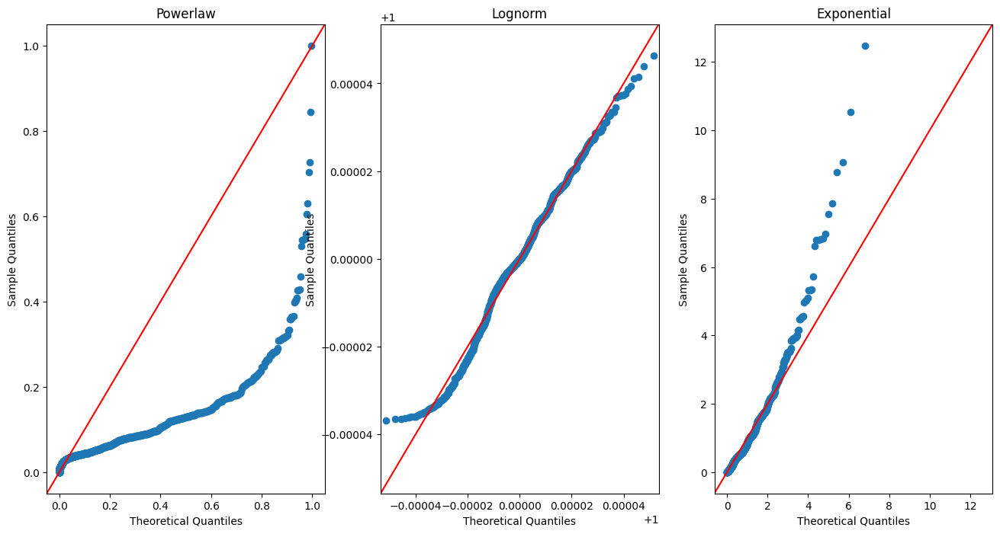

In [94]:
# Interevent
temp = interevent_data
temp = temp["interevent_diff"]

fig, ax = plt.subplots(1, 3, figsize=(16, 8))

qqplot(temp, scipy.stats.distributions.powerlaw, line="45", fit=True, ax=ax[0])
ax[0].set_title("Powerlaw")

qqplot(np.log(temp), scipy.stats.distributions.lognorm, line="45", fit=True, ax=ax[1])
ax[1].set_title("Lognorm")

qqplot(temp, scipy.stats.distributions.expon, line="45", fit=True, ax=ax[2])
ax[2].set_title("Exponential")

if save_figs:
    plt.savefig("figures/seed_inter-event-qqplots.jpg")
plt.show()

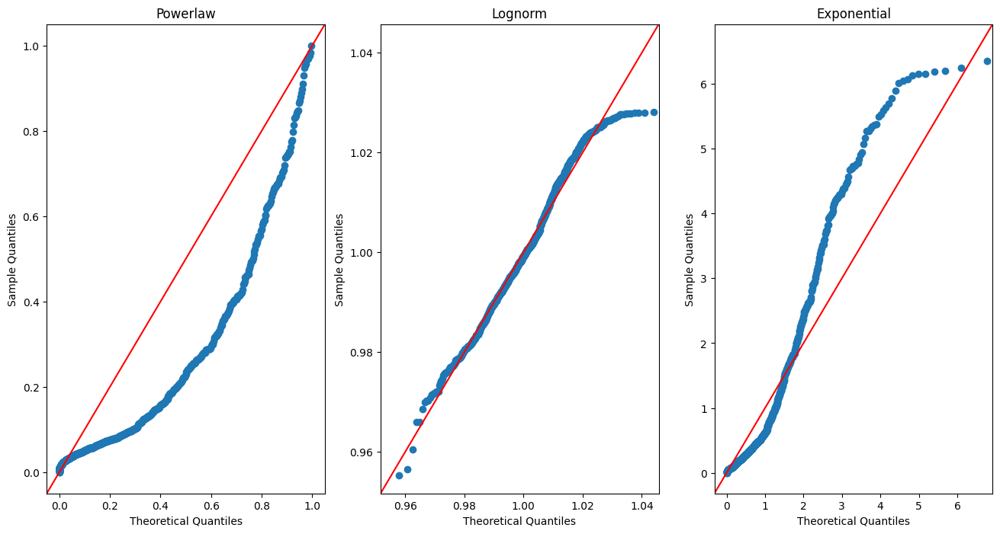

In [95]:
# Intraevent
temp = intraevent_data
temp = temp[temp["interevent_diff"] != 0.0]["interevent_diff"]

fig, ax = plt.subplots(1, 3, figsize=(16, 8))

qqplot(temp, scipy.stats.distributions.powerlaw, line="45", fit=True, ax=ax[0])
ax[0].set_title("Powerlaw")

qqplot(np.log(temp), scipy.stats.distributions.lognorm, line="45", fit=True, ax=ax[1])
ax[1].set_title("Lognorm")

qqplot(temp, scipy.stats.distributions.expon, line="45", fit=True, ax=ax[2])
ax[2].set_title("Exponential")

if save_figs:
    plt.savefig("figures/seed_inter-event-qqplots.jpg")
plt.show()

In [96]:
# Perform Kolmogorov-Smirnov test
fit = powerlaw.Fit(xmin=temp.min(), xmax=temp.max(), data=temp)

for i, j in zip([fit.power_law.cdf, fit.lognormal.cdf, fit.exponential.cdf], ["powerlaw", "lognormal", "expon"]):
    ks_statistic, p_value = kstest(temp, i)

    print(f"{j} KS Statistic: {ks_statistic}")
    print(f"{j} P-value: {p_value}")

powerlaw KS Statistic: 0.45903843356491575
powerlaw P-value: 1.6468046897574e-170
lognormal KS Statistic: 0.062385065325702316
lognormal P-value: 0.0019932068854645094
expon KS Statistic: 0.18645782780689635
expon P-value: 2.5653466475334715e-27


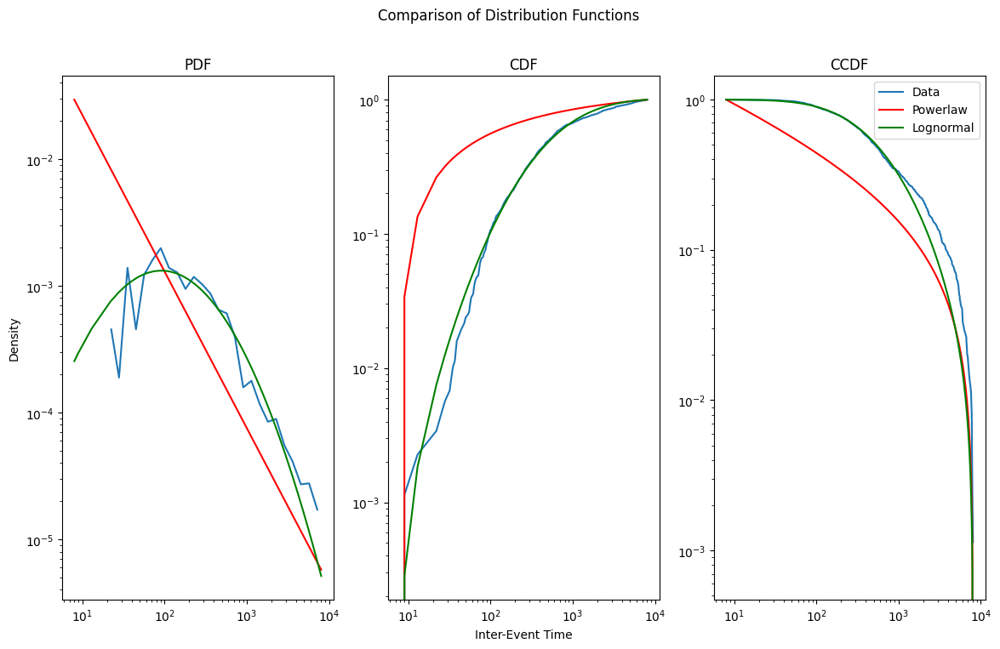

In [97]:
fig, axs = plt.subplots(1, 3, figsize=(14, 8))

fit.plot_pdf(ax=axs[0])
fit.power_law.plot_pdf(color="r", ax=axs[0])
fit.lognormal.plot_pdf(color="g", ax=axs[0])
# fit.exponential.plot_pdf(color="r", ax=axs[0])

fit.plot_cdf(ax=axs[1])
fit.power_law.plot_cdf(color="r", ax=axs[1])
fit.lognormal.plot_cdf(color="g", ax=axs[1])
# fit.exponential.plot_cdf(color="r", ax=axs[1])

fit.plot_ccdf(ax=axs[2], label="Data")
fit.power_law.plot_ccdf(color="r", ax=axs[2], label="Powerlaw")
fit.lognormal.plot_ccdf(color="g", ax=axs[2], label="Lognormal")
# fit.exponential.plot_ccdf(color="r", ax=axs[2], label="Exponential")

axs[0].set_ylabel("Density")
axs[0].set_title("PDF")

axs[1].set_xlabel("Inter-Event Time")
axs[1].set_title("CDF")

axs[2].set_title("CCDF")

plt.legend()
plt.suptitle("Comparison of Distribution Functions")
if save_figs:
    plt.savefig("figures/seed_inter-event-pdf.jpg")
plt.show()

In [98]:
mu = fit.lognormal.mu
sigma = fit.lognormal.sigma
alpha = fit.power_law.alpha

print(f"Lognorm mu: {mu}")
print(f"Lognorm sigma: {sigma}")
print(f"Powerlaw alpha: {alpha}")

Lognorm mu: 6.321869947617912
Lognorm sigma: 1.343892447650014
Powerlaw alpha: 1.2355100532588577


In [99]:
# Compare power law with exponential distribution
R, p = fit.distribution_compare("power_law", "exponential")
print(f"power-law vs. exponential: R = {R}, p = {p}")

# Compare power law with log-normal distribution
R, p = fit.distribution_compare("power_law", "lognormal")
print(f"power-law vs. log-normal: R = {R}, p = {p}")

power-law vs. exponential: R = -554.7420890532854, p = 1.8496221474340856e-92
power-law vs. log-normal: R = -649.6763765505262, p = 2.7196400250221616e-238


In [100]:
# Lognormal dist fits data best ()
x = 3600
cdf_value = round(scipy.stats.lognorm.sf(x, s=fit.lognormal.sigma, scale=np.exp(fit.lognormal.mu)), 3)
print(f"P(i) at {round(x/60/60, 2)}h ({x}s) is {cdf_value}")

P(i) at 1.0h (3600s) is 0.082


In [126]:
# I get the longest IE diff of all simulations (per topic and sub)
sim_max_ie_diff = sim_discussions_data.groupby(
    ["subreddit", "topic"]
)["created_at"].agg(lambda x: (x.max() - x.min()).total_seconds()).max()

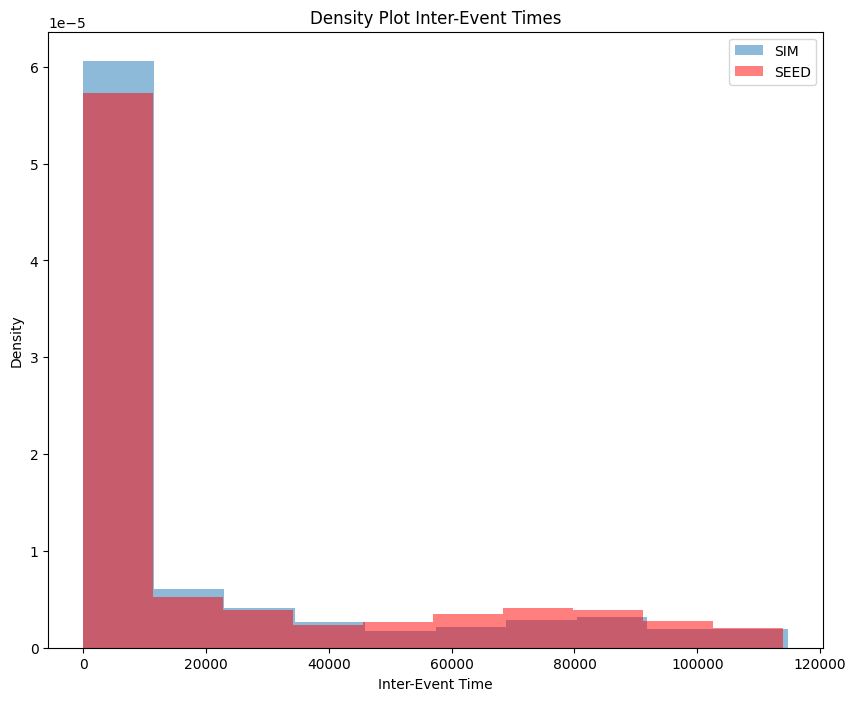

In [129]:
fig, axs = plt.subplots(1, 1, figsize=(10, 8))

axs.hist([i for i in ie_times_sim if i < sim_max_ie_diff], density=True, alpha=0.5, label="SIM")
axs.hist([i for i in ie_times_seed if i < sim_max_ie_diff], density=True, alpha=0.5, bins=10, label="SEED", color="r")
# axs.hist(temp, density=True, bins=5468)

axs.set_xlabel("Inter-Event Time")
# axs.set_xscale("log")
# axs.set_xlim(0, 180000)
axs.set_ylabel("Density")
# axs.set_yscale("log")


plt.title("Density Plot Inter-Event Times")
plt.legend()
if save_figs:
    plt.savefig("figures/seed-sim_ie-times-dist.jpg")
plt.show()

In [182]:
kstest([i for i in ie_times_sim if i < sim_max_ie_diff], [i for i in ie_times_seed if i < sim_max_ie_diff])

KstestResult(statistic=0.37950018823160825, pvalue=4.978031021652474e-121, statistic_location=1066.0, statistic_sign=-1)

In [223]:
bins = np.concatenate(([0],2 ** np.arange(20)))
bins

array([     0,      1,      2,      4,      8,     16,     32,     64,
          128,    256,    512,   1024,   2048,   4096,   8192,  16384,
        32768,  65536, 131072, 262144, 524288])

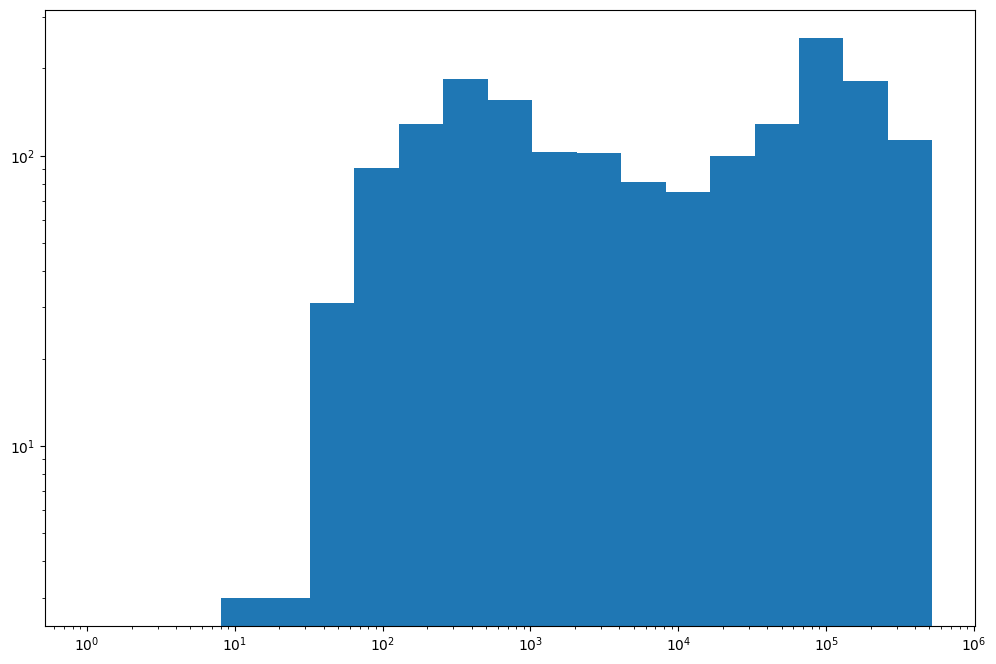

In [225]:
fig, ax = plt.subplots(1,1, figsize=(12, 8))

ax.hist(discussions_data["interevent_diff"], bins=bins)

ax.set_xscale("log")
ax.set_yscale("log")

if save_figs:
    plt.savefig("figures/seed_log-ie-dist.jpg")
plt.show()

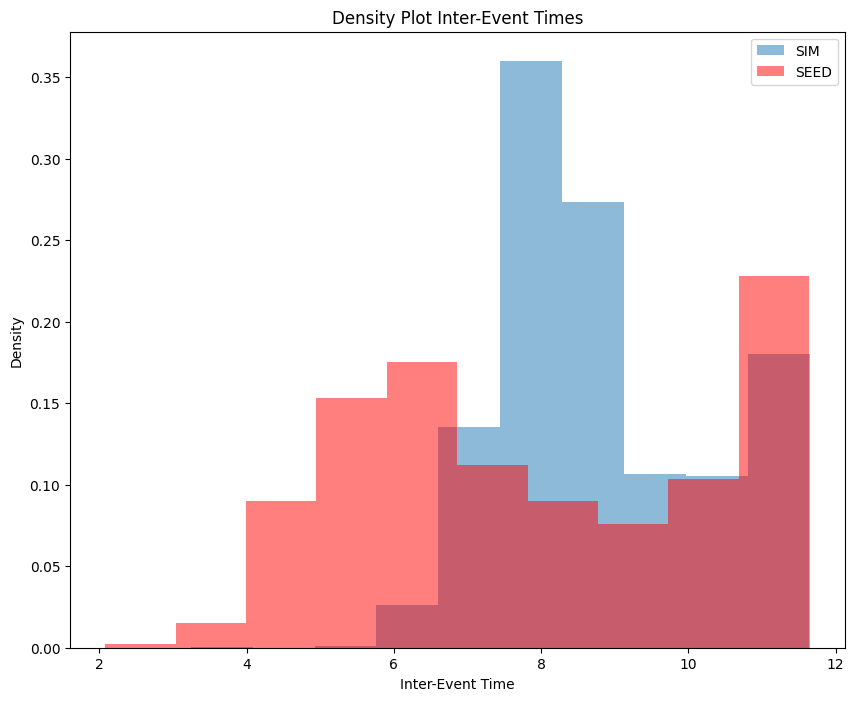

In [128]:
fig, axs = plt.subplots(1, 1, figsize=(10, 8))

axs.hist(np.log([i for i in ie_times_sim if i < sim_max_ie_diff]), density=True, alpha=0.5, label="SIM")
axs.hist(np.log([i for i in ie_times_seed if i < sim_max_ie_diff]), density=True, alpha=0.5, bins=10, label="SEED", color="r")
# axs.hist(temp, density=True, bins=5468)

axs.set_xlabel("Inter-Event Time")
axs.set_ylabel("Density")


plt.title("Density Plot Inter-Event Times")
plt.legend()
if save_figs:
    plt.savefig("figures/seed-sim_ie-times-dist.jpg")
plt.show()

***
# Interaction Analysis

In [38]:
discussions_data["created_comment"] = pd.to_datetime(
    discussions_data["created_comment"]
)
discussions_data.groupby(["subreddit", "post_title"])["created_comment"].transform(
    lambda x: x.max() - x.min()
).median()

Timedelta('6 days 00:31:01')

In [39]:
# Correlation between self-reported vars and comment # for llm agents
for j in ["polinterest", "time_online", "social_media", "comments_online"]:
        corr = scipy.stats.spearmanr(sim_user_data["sim_comment_count"],
                                     sim_user_data[j])
        print(j, corr[0], corr[1])

polinterest 0.09686059594955441 0.1958342063226237
time_online 0.31114300028330194 2.124874486747497e-05
social_media 0.2761808065879081 0.00017487261110612026
comments_online 0.8654811425493724 2.5127358023773473e-55


In [40]:
# Correlation between self-reported vars and comment # for llm agents
for j in ["polinterest", "time_online", "social_media", "comments_online"]:
        corr = scipy.stats.spearmanr(user_data["comment_count"],
                                     user_data[j])
        print(j, corr[0], corr[1])

polinterest -0.09329179330733586 0.21289682070063573
time_online -0.05610730324775673 0.4543975735117016
social_media 0.003319901272030702 0.9647203003814748
comments_online 0.07317276640285604 0.3289724720627104


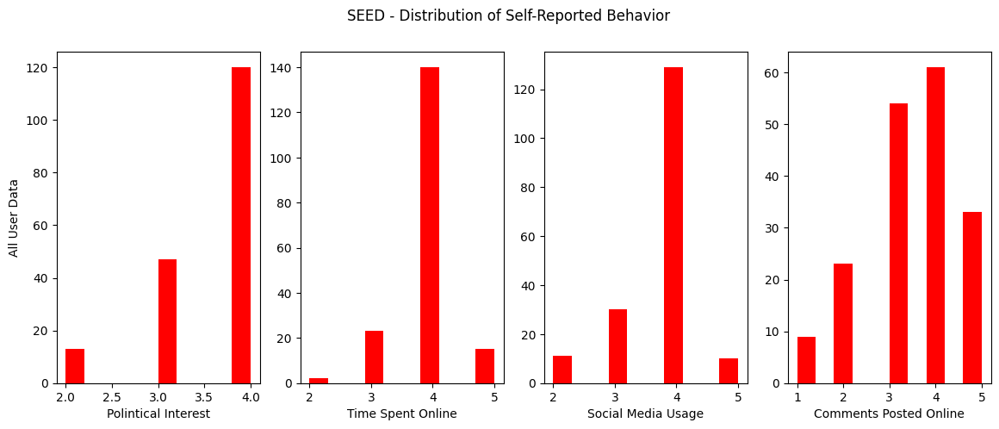

In [41]:
# Comparison of self-reported vars in whole sample vs. Sub 1
plt.rcParams["axes.prop_cycle"] = plt.cycler(color="r")
fig, axs = plt.subplots(1, 4, figsize=(14, 5))

axs[0].hist(user_data["polinterest"])
axs[0].set_xlabel("Polintical Interest")
axs[0].set_ylabel("All User Data")

axs[1].hist(user_data["time_online"])
axs[1].set_xlabel("Time Spent Online")

axs[2].hist(user_data["social_media"])
axs[2].set_xlabel("Social Media Usage")

axs[3].hist(user_data["comments_online"])
axs[3].set_xlabel("Comments Posted Online")

plt.suptitle("SEED - Distribution of Self-Reported Behavior")
if save_figs:
    plt.savefig("figures/seed_self-reports.jpg")
plt.show()

***
# Content Analysis

In [42]:
with open("perspective_secret.txt", "r") as f:
    api_key = f.read()

# perspective_data = pu.query_perspective_df(sim_discussions_data, "content", api_key)

perspective_data.to_csv("/../abyss/home/oasis/data/sim_discussions_data_perspective.csv", index=False)

NameError: name 'perspective_data' is not defined

In [ ]:
list(sim_discussions_data["content"])[744]

In [ ]:
perspective_data.head()

In [ ]:
print(perspective_data["content_toxicity"].mean())
perspective_data.groupby("seed_post_content")["content_toxicity"].apply(np.mean)

In [ ]:
print(discussions_data["comment_toxicity"].mean())
discussions_data[discussions_data["subreddit"] == 2].groupby("post_title")["comment_toxicity"].apply(np.mean)